In [1]:
import numpy as np
import datetime
import pandas as pd
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import matplotlib.patches as patches

from b_utils_Tinti import distance_point_from_plane_pos_neg
from b_utils_Tinti import compute_b_value
from b_utils_Tinti import plot_histo_selection
from typing import Union, Tuple
from pyproj import Proj

In [2]:
# Proj utm zone 33 Central Italy
utm33=Proj(proj='utm',zone=33,ellps='WGS84', preserve_units=False)

In [3]:
#Input parameters:

#DEFINE DeltaM (resolution of the catalog)
interval=0.01

#dmc_value for b_positive (minimum positive differences among events ordered in time) 
#(Lippiello and Petrillo 2024, https://doi.org/10.1029/ 2023JB027849)
dmc_value=0.01

if dmc_value < 0:
    raise ValueError("dmc must be larger or equal to 0")
elif dmc_value < interval:
    warnings.warn("dmc is smaller than delta_m, not recommended")


In [4]:
import sys
sys.version

'3.11.5 (main, Sep 11 2023, 08:31:25) [Clang 14.0.6 ]'

In [5]:
if sys.version_info < (3, 10):
    print("The b_positive function uses some syntax that is only compatible with Python 3.10 and above,such as the | operator for type hints (float | None). In Python 3.9, you’ll need to replace these type hints with Union from the typing module.There is already the commented version in the code that you can replace and use. Please check it!")
else:
    print("This Python is ok! This code is written for Python 3.10 and above")

This Python is ok! This code is written for Python 3.10 and above


In [6]:
##Functions of b_positive taken from seismostats.readthedocs.io
##https://github.com/swiss-seismological-service/SeismoStats

##if python is >= 3.10 
def estimate_b_positive(
    magnitudes: np.ndarray,
    delta_m: float = 0,
    dmc: float | None = None,
    b_parameter: str = "b_value",
    return_std: bool = False,
    return_n: bool = False,
) -> float | tuple[float, float] | tuple[float, float, float]:
    
##if python is < 3.10 substitute with the following:    
#from typing import Union, Tuple
#
#def estimate_b_positive(
#    magnitudes: np.ndarray,
#    delta_m: float = 0,
#    dmc: Union[float, None] = None,
#    b_parameter: str = "b_value",
#    return_std: bool = False,
#    return_n: bool = False,
#) -> Union[float, Tuple[float, float], Tuple[float, float, float]]:
    
    """Return the b-value estimate calculated using the
    positive differences between consecutive magnitudes.

    Source:
        Van der Elst 2021 (J Geophysical Research: Solid Earth, Vol 126, Issue
        2)

    Args:
        magnitudes: array of magnitudes, sorted in time (first
                    entry is the earliest earthquake).
                    To achieve the effect
                    of reduced STAI, the magnitudes must be ordered in time.
        delta_m:    discretization of magnitudes. default is no discretization.
        dmc:       cutoff value for the differences (diffferences below this
                value are not considered). If None, the cutoff is set to delta_m
        b_parameter:either 'b-value', then the corresponding value  of the
                Gutenberg-Richter law is returned, otherwise 'beta' from the
                exponential distribution [p(M) = exp(-beta*(M-mc))].
        return_std: if True the standard deviation of beta/b-value (see above)
                is returned.
        return_n:   if True the number of events used for the estimation is
                returned.

    Returns:
        b:      maximum likelihood beta or b-value, depending on value of
                input variable 'b_parameter'. Note that the difference is just a
                factor [b_value = beta * log10(e)]
        std:    Shi and Bolt estimate of the beta/b-value estimate
        n:      number of events used for the estimation
    """

    if dmc is None:
        dmc = delta_m
    elif dmc < 0:
        raise ValueError("dmc must be larger or equal to 0")
    elif dmc < delta_m:
        warnings.warn("dmc is smaller than delta_m, not recommended")

    mag_diffs = np.diff(magnitudes)
    # only take the values where the next earthquake is d_mc larger than the
    # previous one. delta_m is added to avoid numerical errors
    mag_diffs = abs(mag_diffs[mag_diffs > dmc - delta_m / 2])
    out = estimate_b_classic(
        mag_diffs,
        mc=dmc,
        delta_m=delta_m,
        b_parameter=b_parameter,
        return_std=return_std,
    )

    if return_n:
        if type(out) is tuple:
            return out + tuple([len(mag_diffs)])
        else:
            return out, len(mag_diffs)
    else:
        return out
############################

In [7]:
##Functions taken from seismostats.readthedocs.io
##https://github.com/swiss-seismological-service/SeismoStats
def beta_to_b_value(beta: float) -> float:
    """converts the beta value to the b-value  of the Gutenberg-Richter law

    Args:
        beta: beta value

    Returns:
        b_value: corresponding b-value
    """
    return beta / np.log(10)

###############################

def shi_bolt_confidence(
    magnitudes: np.ndarray,
#    b: Union[float, None] = None,# for Python < 3.10
    b: float | None = None,# for Python >= 3.10
    b_parameter: str = "b_value",
) -> float:
    """Return the Shi and Bolt (1982) confidence limit of the b-value or
    beta.

    Source:
        Shi and Bolt, BSSA, Vol. 72, No. 5, pp. 1677-1687, October 1982

    Args:
        magnitudes: numpy array of magnitudes
        b:          known or estimated b-value/beta of the magnitudes
        b_parameter:either either 'b_value' or 'beta'

    Returns:
        std_b:  confidence limit of the b-value/beta value (depending on input)
    """
    # standard deviation in Shi and Bolt is calculated with 1/(N*(N-1)), which
    # is by a factor of sqrt(N) different to the std(x, ddof=1) estimator
    assert (
        b_parameter == "b_value" or b_parameter == "beta"
    ), "please choose either 'b_value' or 'beta' as b_parameter"

    std_b = (
        np.log(10) * b**2 * np.std(magnitudes) / np.sqrt(len(magnitudes) - 1)
    )
    if b_parameter == "beta":
        std_b = (std_b) / np.log(10)

    return std_b
##################################
##if python is >= 3.10 
def estimate_b_classic(
    magnitudes: np.ndarray,
    mc: float,
    delta_m: float = 0,
    weights: list | None = None,
    b_parameter: str = "b_value",
    return_std: bool = False,
) -> float | tuple[float, float]:
##if python is < 3.10     
#def estimate_b_classic(
#    magnitudes: np.ndarray,
#    mc: float,
#    delta_m: float = 0,
#    weights: Union[list, None] = None,
#    b_parameter: str = "b_value",
#    return_std: bool = False,
#) -> Union[float, Tuple[float, float]]:
    """Return the maximum likelihood b-value or beta for
    an array of magnitudes and a completeness magnitude mc.
    If the magnitudes are discretized, the discretization must be given in
    ``delta_m``, so that the maximum likelihood estimator can be calculated
    correctly.


    Source:
        - Aki 1965 (Bull. Earthquake research institute, vol 43, pp 237-239)
        - Tinti and Mulargia 1987 (Bulletin of the Seismological Society of
          America, 77(6), 2125-2134.)

    Args:
        magnitudes: vector of magnitudes, unsorted, already cutoff (no
                    magnitudes below mc present)
        mc:         completeness magnitude
        delta_m:    discretization of magnitudes. default is no discretization
        weights:    weights of each magnitude can be specified here
        b_parameter:either 'b-value', then the corresponding value  of the
                Gutenberg-Richter law is returned, otherwise 'beta' from the
                exponential distribution [p(M) = exp(-beta*(M-mc))]
        return_std: if True the standard deviation of beta/b-value (see above)
                is returned

    Returns:
        b:      maximum likelihood beta or b-value, depending on value of
                input variable 'b_parameter'. Note that the difference
                is just a factor [b_value = beta * log10(e)]
        std:    Shi and Bolt estimate of the beta/b-value estimate
    """

    if delta_m > 0:
        p = 1 + delta_m / np.average(magnitudes - mc, weights=weights)
        beta = 1 / delta_m * np.log(p)
    else:
        beta = 1 / np.average(magnitudes - mc, weights=weights)

    if b_parameter == "b_value":
        b = beta_to_b_value(beta)
    elif b_parameter == "beta":
        b = beta
    else:
        raise ValueError(
            "please choose either 'b_value' or 'beta' as b_parameter"
        )

    std = shi_bolt_confidence(magnitudes, b=b, b_parameter=b_parameter)

    if return_std is True:
        return b, std
    else:
        return b

In [8]:
print('The seismicity catalogue used in this work is published in Tan et al., 2021 and is available at the Zenodo dataset repository (https://zenodo.org/records/4662870)')
am=pd.read_csv('./Amatrice_CAT5.v20210325', delimiter='\s+',header=19)

The seismicity catalogue used in this work is published in Tan et al., 2021 and is available at the Zenodo dataset repository (https://zenodo.org/records/4662870)


In [9]:
am.columns = [ "year","month","day","hour","min","secmsec","lat", "lon", "depth","EH1","EH2","AZ","EZ","Ml","Mw","Id"]

In [10]:
#select only the columns usefull for the study
am =am.drop(['EH1','EH2','AZ','EZ'], axis = 1)
df = pd.DataFrame({'year': am['year'],
                       'month': am['month'],
                       'day': am['day'],'hour': am['hour'],
                       'minute': am['min'], 'second':am['secmsec']})
time=pd.to_datetime(df, format = '%d/%m/%y %H:%M:%S')
#Convert argument to datetime
am['time']=time
am=am.drop(['year', 'month','day','hour','min','secmsec'], axis=1)
am = am.dropna()
am = am.reset_index(drop=True)

In [11]:
am

,lat,lon,depth,Ml,Mw,Id,time
0,42.30519,13.68531,6.154,0.96,1.47,100587992,2016-08-15 00:35:59.228
1,43.52994,12.65680,14.826,0.00,0.82,100587994,2016-08-15 00:40:55.000
2,43.16713,12.99694,8.917,-0.23,0.67,100587995,2016-08-15 00:43:23.710
3,43.31555,12.55297,3.274,-0.93,0.25,100587998,2016-08-15 01:03:16.243
4,43.46923,12.43279,3.447,-1.00,0.21,100587999,2016-08-15 01:26:53.220
...,...,...,...,...,...,...,...
894437,42.81393,13.10829,7.216,-0.33,0.61,101373261,2017-08-15 23:55:17.090
894438,42.80558,13.14988,3.126,0.09,0.88,101373262,2017-08-15 23:55:55.167
894439,43.00835,13.14668,1.336,-0.24,0.67,101373264,2017-08-15 23:56:16.970
894440,42.66073,13.21744,4.262,-0.21,0.68,101373266,2017-08-15 23:59:26.632


### Projection

In [12]:
# to utm33
utmx_am,utmy_am=utm33(np.array(am['lon']),np.array(am['lat']))

In [13]:
#In this catalog (Tan et al 2021) Amatrice event has the largest Magnitude. However  from moment tensor analysis
#it results that Mw=6.1 for Amatrice event and Mw=6.5 for Norcia event.
where_max_mag=np.argmax(am['Mw'])
print(np.max(am['Mw']))
print(am['time'][where_max_mag])

6.08
2016-08-24 01:36:33.478000


In [14]:
large=am[(am['Mw'] >= 5.)]
large= large.reset_index(drop=True)
large

,lat,lon,depth,Ml,Mw,Id,time
0,42.71446,13.24279,3.276,6.03,6.08,100589404,2016-08-24 01:36:33.478
1,42.80178,13.15885,4.113,5.15,5.14,100589605,2016-08-24 02:33:29.980
2,42.88725,13.12915,1.672,5.25,5.24,100058175,2016-10-26 17:10:37.256
3,42.91094,13.13936,2.605,5.67,5.69,100058905,2016-10-26 19:18:06.687
4,42.87728,13.04380,12.790,5.33,5.33,100058906,2016-10-26 19:18:08.534
5,42.83603,13.12131,6.104,6.02,6.06,100091114,2016-10-30 06:40:18.291
6,42.56382,13.29714,6.164,5.26,5.26,200000547,2017-01-18 09:25:41.253
7,42.56016,13.29027,6.702,5.13,5.12,200000776,2017-01-18 10:14:10.860
8,42.46175,13.33802,6.777,5.14,5.13,200000830,2017-01-18 10:25:23.543
9,42.49855,13.27593,6.903,5.24,5.23,200001894,2017-01-18 13:33:37.813


In [15]:
#Reference earthquake that is the center of the section Norcia 30 10 2016
ev=5
lon_ref=large['lon'].iloc[ev]
lat_ref=large['lat'].iloc[ev]
depth_ref=large['depth'].iloc[ev]

utmx_ref,utmy_ref=utm33(lon_ref,lat_ref)
mainev_ref=[utmx_ref/1000,utmy_ref/1000, -depth_ref ]
mainev_ref=np.array(mainev_ref)
#print(mainev_ref)

In [16]:
#strike_ref=150
#normal_tostrike=strike_ref-90   
dip_angle=90
normal_tostrike=155-90   #direction of the section to plot
normal_ref=[np.sin(dip_angle*np.pi/180)*np.cos(normal_tostrike*np.pi/180),-np.sin(normal_tostrike*np.pi/180)*np.sin(dip_angle*np.pi/180),np.cos(dip_angle*np.pi/180)]

In [17]:
#distance from a plane
distam_ref=distance_point_from_plane_pos_neg(utmx_am/1000,utmy_am/1000, -am['depth'], normal_ref, mainev_ref)
#distance from a plane < x 
loo=-5
laa=+5
resultdist1m = np.where((distam_ref >loo)&(distam_ref <laa))
#distance on a section
X_onsection1m=+(utmy_am[resultdist1m]/1000-mainev_ref[1])*normal_ref[0]-(utmx_am[resultdist1m]/1000-mainev_ref[0])*normal_ref[1]
# Mainshock or selected event on section
fm_onsection_ref=+(utmy_ref/1000-mainev_ref[1])*normal_ref[0]-(utmx_ref/1000-mainev_ref[0])*normal_ref[1]

Text(0.5, 1.0, ' Thickness of seismicity: -5,  5')

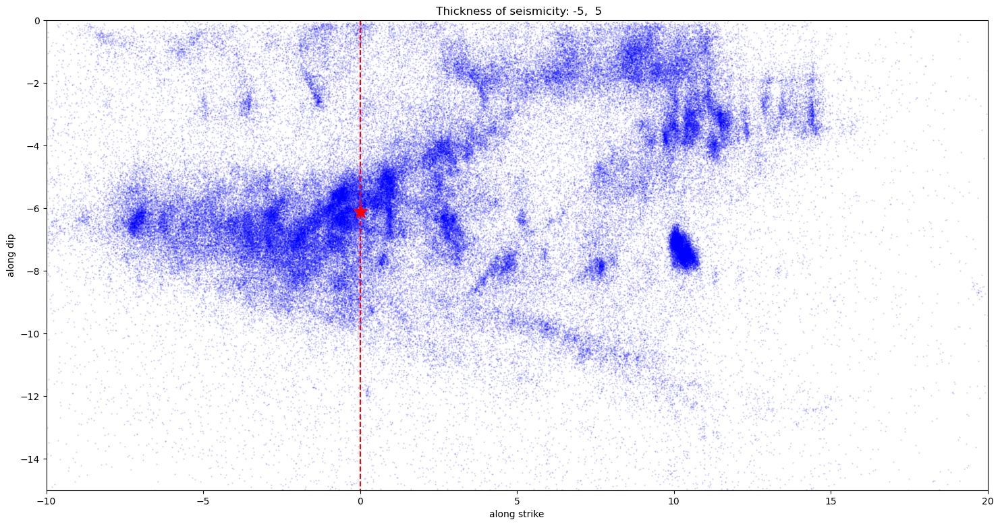

In [18]:
%matplotlib inline

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(18, 10))

ax.scatter(X_onsection1m,(-am['depth'].loc[resultdist1m])/np.sin(dip_angle*np.pi/180),c='b',s=1,marker='.',alpha=.2,label='x')
ax.scatter(fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180), marker='*', c='r',s=250, label='Mw 6.5')
ax.plot([0,0],[0, -15],'r--')
ax.set_ylim(-15,0)
ax.set_xlim(-10,20)

ax.set_aspect('equal', adjustable='box')
ax.set_ylabel('along dip')
ax.set_xlabel('along strike')
ax.set_title(' Thickness of seismicity: '+str(loo)+',  '+str(laa))


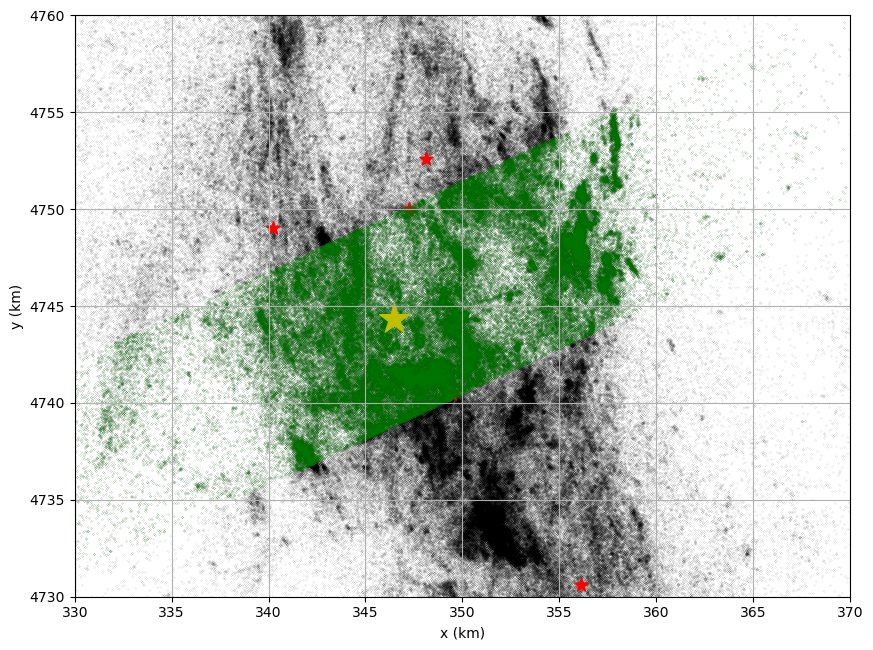

In [19]:
#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)
ax.scatter(utmx_am/1000, utmy_am/1000,s=0.01,marker='.', c='k', label='Tan et al., 2021',rasterized=True)
ax.scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='r')

ax.scatter(utmx_am[resultdist1m]/1000, utmy_am[resultdist1m]/1000, s=0.05,marker='.', c='g', alpha=0.5,label='Tan et al., 2021')
ax.scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

ax.set_xlim(330,370)
ax.set_ylim(4730,4760)
#plt.legend(fontsize=11, markerscale=2)
plt.xlabel('x (km)')
plt.ylabel('y (km)')
ax=plt.gca()
ax.set_aspect('equal')
ax.grid()

## Dataset whole sequence without STAI

In [20]:
#STAI info taken from Herrmann & Marzocchi (2020)


In [21]:
#PRE_NORCIA
start_date0 = '2016-08-15 00:01 '
end_date0 = '2016-08-24 01:36:34'#'2016-12-09 06:39' STAI 19,2 hours
start_date1 = '2016-08-24 20:36 '
end_date1 = '2016-10-26 19:18:10 '
start_date2 = '2016-10-27 09:18:10 ' #STAI 14,4 hours
end_date2 = '2016-10-30 06:40:19'#'2016-12-09 06:39'

am_PRE = am[((am['time'] >= start_date0) & (am["time"] <= end_date0)) |((am['time'] >= start_date1) & (am["time"] <= end_date1)) | ((am['time'] >= start_date2) & (am["time"] <= end_date2))]
am_PRE= am_PRE.reset_index(drop=True)
am_PRE

,lat,lon,depth,Ml,Mw,Id,time
0,42.30519,13.68531,6.154,0.96,1.47,100587992,2016-08-15 00:35:59.228
1,43.52994,12.65680,14.826,0.00,0.82,100587994,2016-08-15 00:40:55.000
2,43.16713,12.99694,8.917,-0.23,0.67,100587995,2016-08-15 00:43:23.710
3,43.31555,12.55297,3.274,-0.93,0.25,100587998,2016-08-15 01:03:16.243
4,43.46923,12.43279,3.447,-1.00,0.21,100587999,2016-08-15 01:26:53.220
...,...,...,...,...,...,...,...
196323,42.79594,13.17174,5.011,-0.06,0.78,100091106,2016-10-30 06:39:07.206
196324,42.86184,13.15853,2.285,0.65,1.25,100091107,2016-10-30 06:39:13.103
196325,42.81887,13.18376,7.036,0.57,1.19,100091110,2016-10-30 06:39:25.157
196326,42.86442,13.23970,3.714,0.50,1.15,100091112,2016-10-30 06:39:46.649


In [22]:
#POST_NORCIA

start_date3 = '2016-11-01 06:40 ' #STAI 48 hours
end_date3 = '2017-01-18 09:26'#'2016-12-09 06:39'

start_date4 = '2017-01-18 21:00 ' # 9,6 hours
end_date4 = '2017-08-15 22:16'#'2016-12-09 06:39'
am_POST = am[((am['time'] >= start_date3) & (am["time"] <= end_date3)) | ((am['time'] >= start_date4) & (am["time"] <= end_date4))]
am_POST= am_POST.reset_index(drop=True)
am_POST


,lat,lon,depth,Ml,Mw,Id,time
0,43.01112,13.14505,2.403,0.46,1.12,100136314,2016-11-01 06:40:04.830
1,42.85109,13.09862,7.311,1.00,1.50,100136315,2016-11-01 06:40:13.661
2,42.74636,13.23108,8.431,1.07,1.55,100136316,2016-11-01 06:40:17.944
3,42.80096,13.29163,6.415,1.07,1.55,100136317,2016-11-01 06:40:22.135
4,42.81052,13.09539,8.589,1.00,1.50,100136319,2016-11-01 06:40:26.705
...,...,...,...,...,...,...,...
676331,42.96884,13.12397,10.124,-0.34,0.60,101373161,2017-08-15 22:08:08.787
676332,42.94025,13.14054,2.357,-0.68,0.39,101373162,2017-08-15 22:08:46.295
676333,42.95503,13.24975,0.523,-0.95,0.23,101373163,2017-08-15 22:09:11.175
676334,43.58804,12.60519,13.030,-0.49,0.51,101373164,2017-08-15 22:09:22.426


## Plot PRE and POST separately

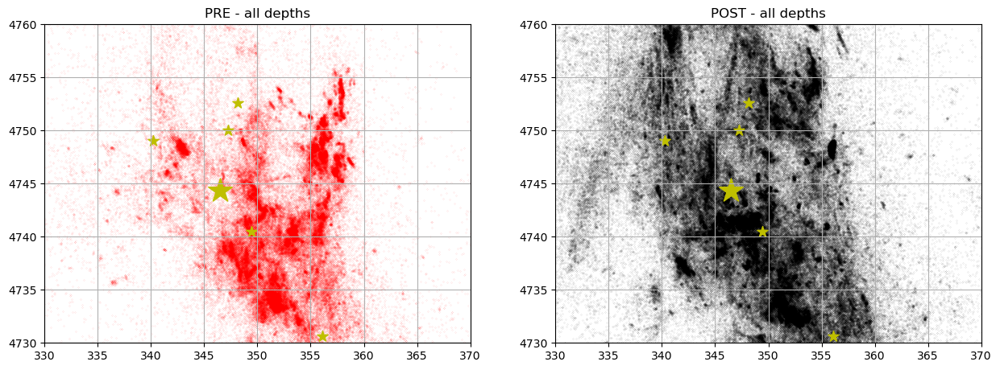

In [23]:
utmx_PRE_tot,utmy_PRE_tot=utm33(np.array(am_PRE['lon']),np.array(am_PRE['lat']))   # 1 day pre M 6.5
utmx_POST_tot,utmy_POST_tot=utm33(np.array(am_POST['lon']),np.array(am_POST['lat']))   # 1 day pre M 6.5

#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PRE_tot/1000, utmy_PRE_tot/1000,s=0.01,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POST_tot/1000, utmy_POST_tot/1000,s=0.01,marker='.', c='k', label='Tan et al., 2021')

axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE - all depths')
axs[1].set_title('POST - all depths')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()

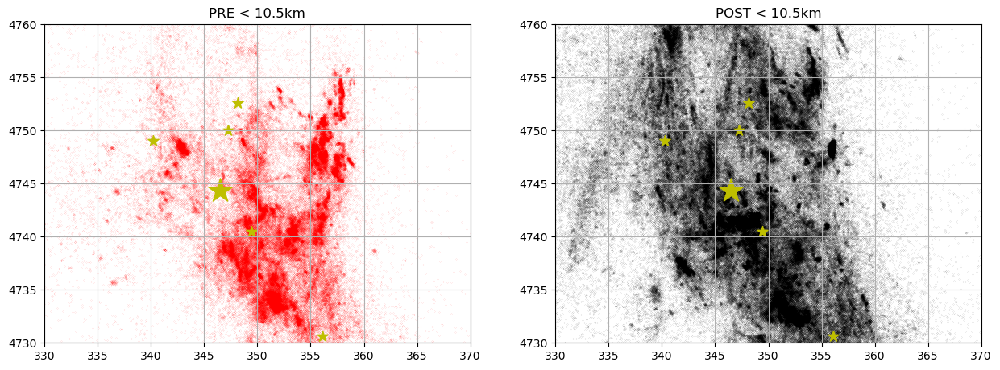

In [24]:
max_depth=10.5
am_PREs=am_PRE[(am_PRE['depth'] >= 0)&(am_PRE['depth'] <= max_depth)]
am_PREs= am_PREs.reset_index(drop=True)

am_POSTs=am_POST[(am_POST['depth'] >= 0)&(am_POST['depth'] <= max_depth)]
am_POSTs= am_POSTs.reset_index(drop=True)
utmx_PRE,utmy_PRE=utm33(np.array(am_PREs['lon']),np.array(am_PREs['lat']))   # 1 day pre M 6.5
utmx_POST,utmy_POST=utm33(np.array(am_POSTs['lon']),np.array(am_POSTs['lat']))   # 1 day pre M 6.5

#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PRE/1000, utmy_PRE/1000,s=0.01,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POST/1000, utmy_POST/1000,s=0.01,marker='.', c='k', label='Tan et al., 2021')

axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE < '+str(max_depth)+'km')
axs[1].set_title('POST < '+str(max_depth)+'km')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()

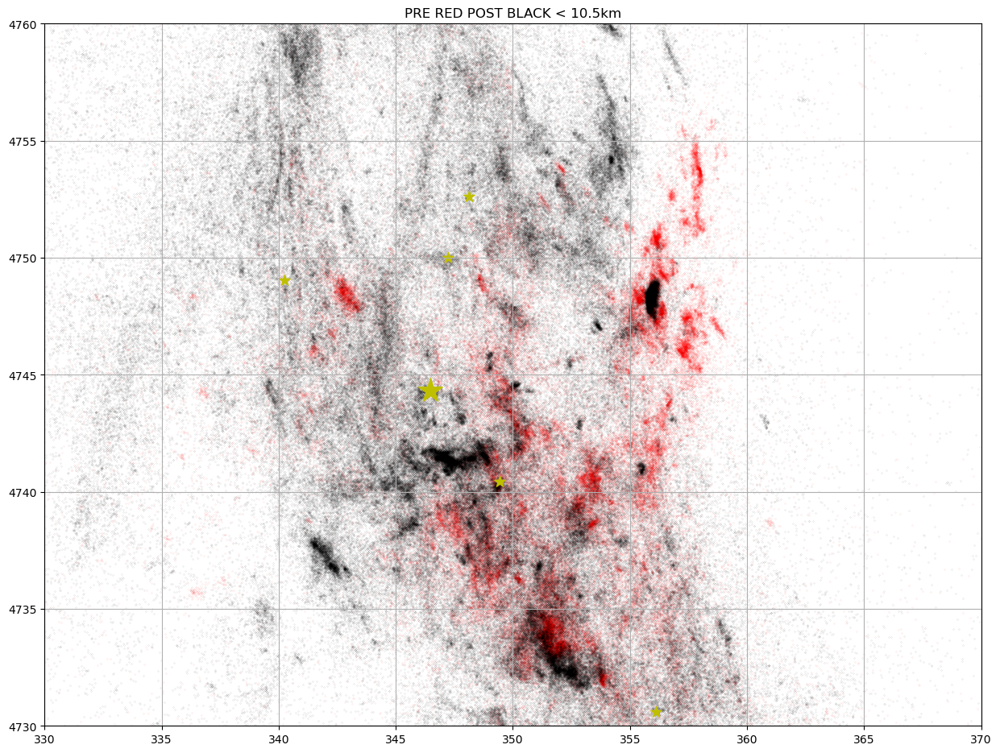

In [25]:
max_depth=10.5
am_PREs=am_PRE[(am_PRE['depth'] >= 0)&(am_PRE['depth'] <= max_depth)]
am_PREs= am_PREs.reset_index(drop=True)

am_POSTs=am_POST[(am_POST['depth'] >= 0)&(am_POST['depth'] <= max_depth)]
am_POSTs= am_POSTs.reset_index(drop=True)
utmx_PRE,utmy_PRE=utm33(np.array(am_PREs['lon']),np.array(am_PREs['lat']))   # 1 day pre M 6.5
utmx_POST,utmy_POST=utm33(np.array(am_POSTs['lon']),np.array(am_POSTs['lat']))   # 1 day pre M 6.5

#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 1, figsize=(15,15))

axs.scatter(utmx_PRE/1000, utmy_PRE/1000,s=0.01,marker='.', c='r', label='Tan et al., 2021')
axs.scatter(utmx_POST/1000, utmy_POST/1000,s=0.01,marker='.', c='k', label='Tan et al., 2021')


axs.scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs.scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs.set_xlim(330,370)
axs.set_ylim(4730,4760)
axs.set_title('PRE RED POST BLACK < '+str(max_depth)+'km')


##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs.set_aspect('equal')
axs.grid()

## b value for the different lithologies

In [26]:
#strike_ref=150
#normal_tostrike=strike_ref-90   
dip_angle=90
normal_tostrike=155-90   #direction of the section to plot
normal_ref=[np.sin(dip_angle*np.pi/180)*np.cos(normal_tostrike*np.pi/180),-np.sin(normal_tostrike*np.pi/180)*np.sin(dip_angle*np.pi/180),np.cos(dip_angle*np.pi/180)]
normal_ref_vertical=[np.cos(normal_tostrike*np.pi/180),-np.sin(normal_tostrike*np.pi/180)]

In [27]:
X_onsection_PRE_tot=+(utmy_PRE_tot /1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_PRE_tot/1000-mainev_ref[0])*normal_ref_vertical[1]


In [28]:
X_onsection_POST_tot=+(utmy_POST_tot/1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_POST_tot/1000-mainev_ref[0])*normal_ref_vertical[1]


In [31]:
B_value5=np.zeros(5)
Bpositive_5Mw=np.zeros(5)
STD_positive=np.zeros(5)

### b value for the Basement volume

In [32]:
#DEPTHS
minB=9.2
maxB=14.



In [33]:

am_PREs=am_PRE[(am_PRE['depth'] >= minB)&(am_PRE['depth'] <= maxB)]
am_PREs= am_PREs.reset_index(drop=True)
am_POSTs=am_POST[(am_POST['depth'] >= minB)&(am_POST['depth'] <= maxB)]
am_POSTs= am_POSTs.reset_index(drop=True)


In [34]:
where_max_mag=np.argmax(am_PREs['Mw'])
am_PREs['time'][where_max_mag]

Timestamp('2016-10-26 19:18:08.534000')

In [35]:
utmx_PREs,utmy_PREs=utm33(np.array(am_PREs['lon']),np.array(am_PREs['lat']))   # 1 day pre M 6.5
X_onsection_PREs=+(utmy_PREs/1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_PREs/1000-mainev_ref[0])*normal_ref_vertical[1]
utmx_POSTs,utmy_POSTs=utm33(np.array(am_POSTs['lon']),np.array(am_POSTs['lat']))   # 1 day pre M 6.5
X_onsection_POSTs=+(utmy_POSTs/1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_POSTs/1000-mainev_ref[0])*normal_ref_vertical[1]


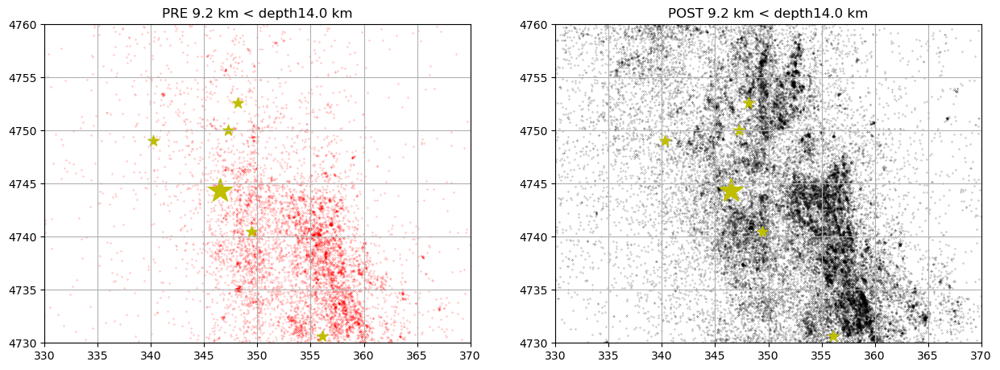

In [36]:

#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PREs/1000, utmy_PREs/1000,s=0.1,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTs/1000, utmy_POSTs/1000,s=0.1,marker='.', c='k', label='Tan et al., 2021')

axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE '+str(minB)+' km < depth' + str(maxB) +' km')
axs[1].set_title('POST '+str(minB)+' km < depth' + str(maxB) +' km')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()

Text(0.5, 1.0, ' All the events with not selection with distance')

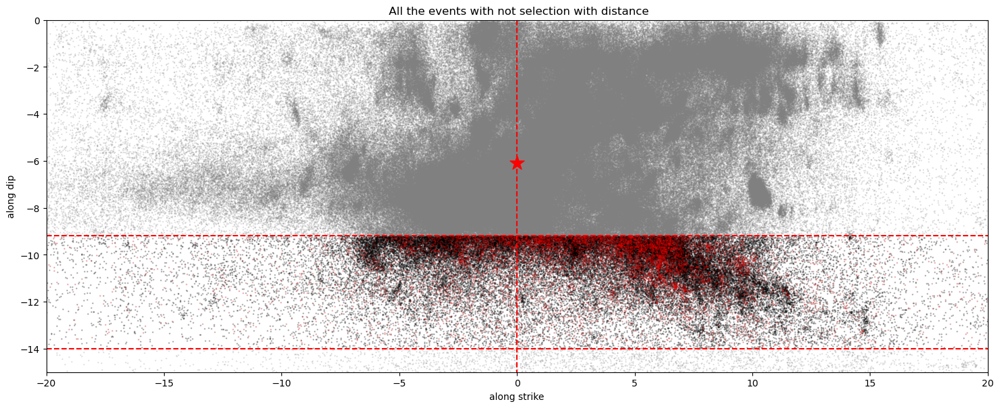

In [37]:
%matplotlib inline

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(18, 10))

ax.scatter( X_onsection_POST_tot,(-am_POST['depth'])/np.sin(dip_angle*np.pi/180),c='gray',s=2,marker='.',alpha=.2,label='x')
ax.scatter( X_onsection_PRE_tot,(-am_PRE['depth'])/np.sin(dip_angle*np.pi/180),c='gray',s=2,marker='.',alpha=.2,label='x')


ax.scatter(X_onsection_POSTs,(-am_POSTs['depth'])/np.sin(dip_angle*np.pi/180),c='k',s=2,marker='.',alpha=.2,label='x')
ax.scatter(X_onsection_PREs,(-am_PREs['depth'])/np.sin(dip_angle*np.pi/180),c='r',s=2,marker='.',alpha=.2,label='x')

ax.scatter(fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180), marker='*', c='r',s=250, label='Mw 6.5')
ax.plot([-20,20],[-minB, -minB],'r--')
ax.plot([-20,20],[-maxB, -maxB],'r--')
ax.plot([0,0],[0, -15],'r--')
#ax.plot([16,16],[0, -15],'r--')
ax.set_ylim(-15,0)
ax.set_xlim(-20,20)
ax.set_aspect('equal', adjustable='box')
ax.set_ylabel('along dip')
ax.set_xlabel('along strike')
ax.set_title(' All the events with not selection with distance')

In [38]:

dist_refPOSTs=distance_point_from_plane_pos_neg(utmx_POSTs/1000,utmy_POSTs/1000, -am_POSTs['depth'], normal_ref, mainev_ref)
#distance reference point
dist_refPREs=distance_point_from_plane_pos_neg(utmx_PREs/1000,utmy_PREs/1000, -am_PREs['depth'], normal_ref, mainev_ref)

# DISTANCE ALONG STRIKE
loo=-6
laa=+6

distPREs = np.where((dist_refPREs>loo)&(dist_refPREs<laa))
distPOSTs = np.where((dist_refPOSTs>loo)&(dist_refPOSTs<laa))

result_catal = np.where((distam_ref >loo)&(distam_ref <laa))
X_onsection_catal=+(utmy_am[result_catal]/1000-mainev_ref[1])*normal_ref[0]-(utmx_am[result_catal]/1000-mainev_ref[0])*normal_ref[1]


In [39]:
#distPREs

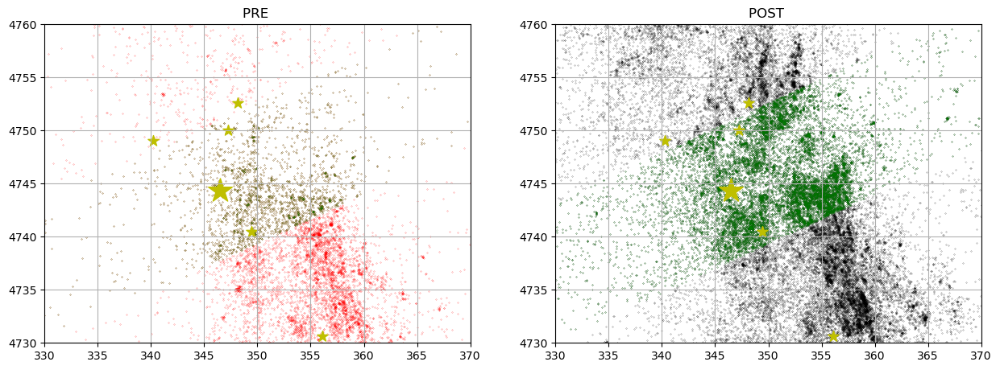

In [40]:

#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PREs/1000, utmy_PREs/1000,s=0.1,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTs/1000, utmy_POSTs/1000,s=0.1,marker='.', c='k', label='Tan et al., 2021')

axs[0].scatter(utmx_PREs[distPREs]/1000, utmy_PREs[distPREs]/1000,s=0.1,marker='.', c='g', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTs[distPOSTs]/1000, utmy_POSTs[distPOSTs]/1000,s=0.1,marker='.', c='g', label='Tan et al., 2021')

axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')


axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE ')
axs[1].set_title('POST ')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()

In [41]:
am_PREs_sel=am_PREs.loc[distPREs]
am_PREs_sel= am_PREs_sel.reset_index(drop=True)
utmx_PREs_sel,utmy_PREs_sel=utm33(np.array(am_PREs_sel['lon']),np.array(am_PREs_sel['lat']))   # 1 day pre M 6.5
X_onsection_PREs_sel=+(utmy_PREs_sel/1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_PREs_sel/1000-mainev_ref[0])*normal_ref_vertical[1]



In [42]:
am_POSTs_sel=am_POSTs.loc[distPOSTs]
am_POSTs_sel= am_POSTs_sel.reset_index(drop=True)
utmx_POSTs_sel,utmy_POSTs_sel=utm33(np.array(am_POSTs_sel['lon']),np.array(am_POSTs_sel['lat']))   # 1 day pre M 6.5
X_onsection_POSTs_sel=+(utmy_POSTs_sel/1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_POSTs_sel/1000-mainev_ref[0])*normal_ref_vertical[1]



Text(0.5, 1.0, ' ')

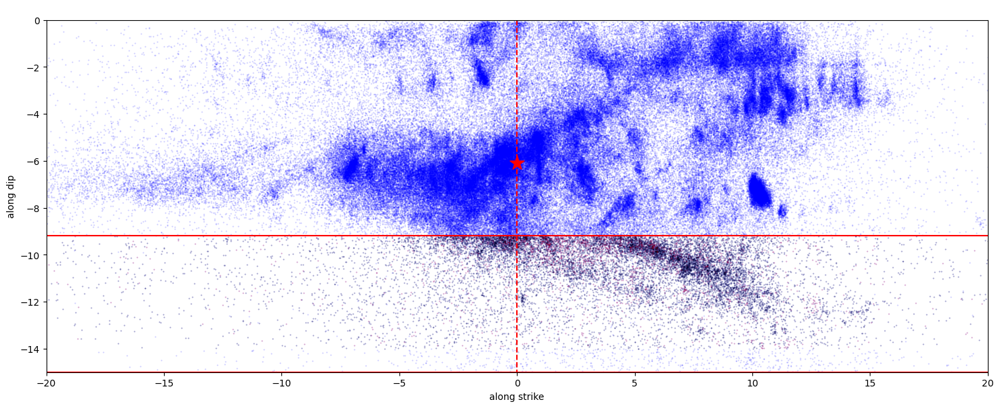

In [43]:
%matplotlib inline

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(18, 10))

ax.scatter( X_onsection_catal,(-am['depth'].loc[result_catal])/np.sin(dip_angle*np.pi/180),c='b',s=1,marker='.',alpha=.2,label='x')
ax.scatter(X_onsection_POSTs_sel,(-am_POSTs_sel['depth'])/np.sin(dip_angle*np.pi/180),c='k',s=1,marker='.',alpha=.2,label='x')
ax.scatter(X_onsection_PREs_sel,(-am_PREs_sel['depth'])/np.sin(dip_angle*np.pi/180),c='r',s=1,marker='.',alpha=.2,label='x')
#
ax.scatter(fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180), marker='*', c='r',s=250, label='Mw 6.5')
ax.plot([-20,20],[-15.0, -15.0],'r')

ax.plot([-20,20],[-9.2, -9.2],'r')
ax.plot([0,0],[0, -15],'r--')

ax.set_ylim(-15,0)
ax.set_xlim(-20,20)
ax.set_aspect('equal', adjustable='box')
ax.set_ylabel('along dip')
ax.set_xlabel('along strike')
ax.set_title(' ')

In [44]:
# DISTANCE ORTHOGONAL TO STRIKE

Xmin=0
#Xmax=+15
Xmax=+12

where_PREs_sel = ((X_onsection_PREs_sel<Xmax) &(X_onsection_PREs_sel>Xmin))
where_POSTs_sel = ((X_onsection_POSTs_sel<Xmax) &(X_onsection_POSTs_sel>Xmin))

In [45]:


am_POSTs_sel_box=am_POSTs_sel.loc[where_POSTs_sel]
am_POSTs_sel_box= am_POSTs_sel_box.reset_index(drop=True)
print(len(am_POSTs_sel_box))
#am_POST_sel=am_POST.copy() #am_poM1.copy()
am_PREs_sel_box=am_PREs_sel.loc[where_PREs_sel]
am_PREs_sel_box= am_PREs_sel_box.reset_index(drop=True)
print(len(am_PREs_sel_box))

10280
1784


In [46]:

utmx_PREs_sel_box,utmy_PREs_sel_box=utm33(np.array(am_PREs_sel_box['lon']),np.array(am_PREs_sel_box['lat']))   # 1 day pre M 6.5
utmx_POSTs_sel_box,utmy_POSTs_sel_box=utm33(np.array(am_POSTs_sel_box['lon']),np.array(am_POSTs_sel_box['lat']))   # 1 day pre M 6.5
print(len(utmx_POSTs_sel_box))


10280


In [47]:
X_on_PREs_sel_box=+(utmy_PREs_sel_box/1000-mainev_ref[1])*normal_ref[0]-(utmx_PREs_sel_box/1000-mainev_ref[0])*normal_ref[1]
X_on_POSTs_sel_box=+(utmy_POSTs_sel_box/1000-mainev_ref[1])*normal_ref[0]-(utmx_POSTs_sel_box/1000-mainev_ref[0])*normal_ref[1]


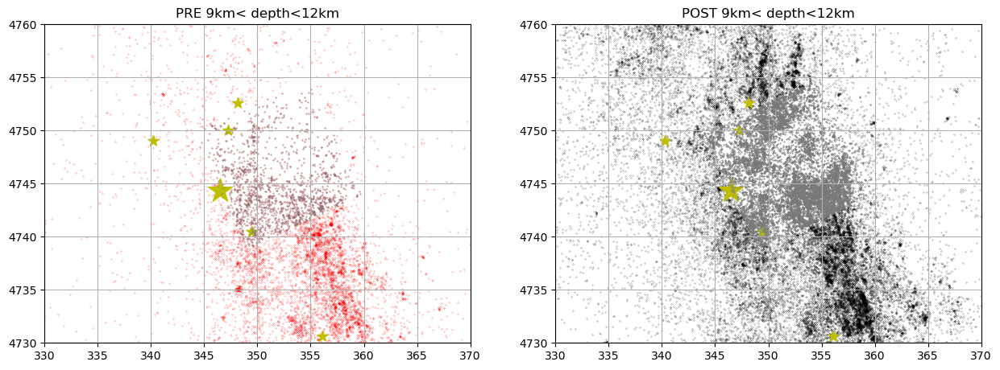

In [48]:

%matplotlib inline
whegrandi=np.where(am['Mw'] >= 5)
#%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PREs/1000, utmy_PREs/1000,s=0.1,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTs/1000, utmy_POSTs/1000,s=0.1,marker='.', c='k', label='Tan et al., 2021')

axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')
axs[0].scatter(utmx_PREs_sel_box/1000, utmy_PREs_sel_box/1000,marker='.',c='gray',s=1,alpha=0.5)
axs[1].scatter(utmx_POSTs_sel_box/1000, utmy_POSTs_sel_box/1000,marker='.',c='gray',s=1,alpha=0.5)

axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE 9km< depth<12km')
axs[1].set_title('POST 9km< depth<12km')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()



Text(0.5, 1.0, ' ')

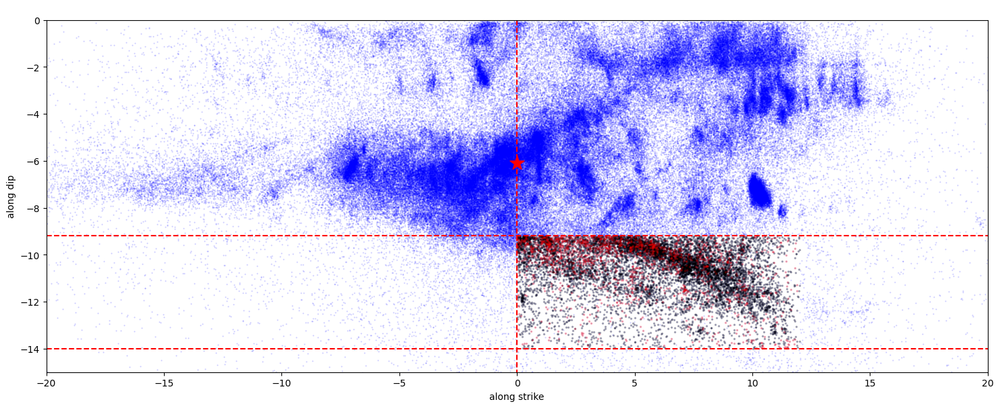

In [49]:
%matplotlib inline

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(18, 10))

ax.scatter( X_onsection_catal,(-am['depth'].loc[result_catal])/np.sin(dip_angle*np.pi/180),c='b',s=1,marker='.',alpha=.2,label='x')
ax.scatter(X_on_POSTs_sel_box,(-am_POSTs_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='k',s=10,marker='.',alpha=.2,label='x')
ax.scatter(X_on_PREs_sel_box,(-am_PREs_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='r',s=10,marker='.',alpha=.2,label='x')

ax.scatter(fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180), marker='*', c='r',s=250, label='Mw 6.5')
ax.plot([-20,20],[-minB, -minB],'r--')
ax.plot([-20,20],[-maxB, -maxB],'r--')
ax.plot([0,0],[0, -15],'r--')
#ax.plot([16,16],[0, -15],'r--')
ax.set_ylim(-15,0)
ax.set_xlim(-20,20)
ax.set_aspect('equal', adjustable='box')
ax.set_ylabel('along dip')
ax.set_xlabel('along strike')
ax.set_title(' ')



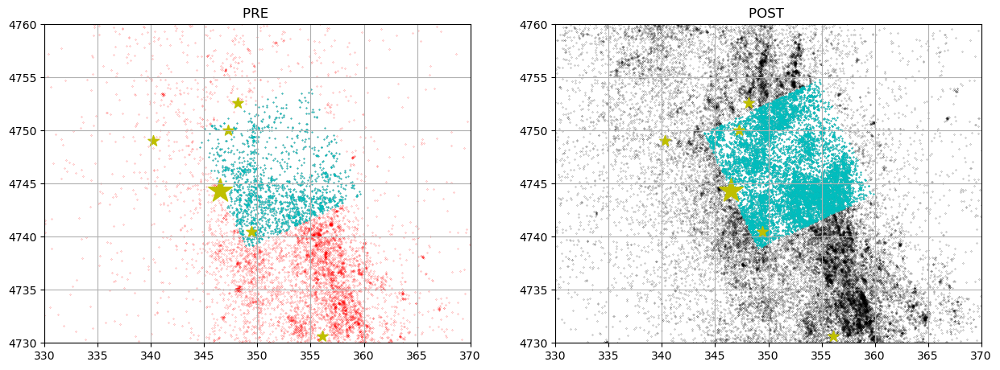

In [50]:
#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PREs/1000, utmy_PREs/1000,s=0.1,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTs/1000, utmy_POSTs/1000,s=0.1,marker='.', c='k', label='Tan et al., 2021')


axs[0].scatter(utmx_PREs_sel_box/1000, utmy_PREs_sel_box/1000,s=1,marker='.', c='c', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTs_sel_box/1000, utmy_POSTs_sel_box/1000,s=1,marker='.', c='c', label='Tan et al., 2021')


axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')


axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE ')
axs[1].set_title('POST ')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()

In [51]:
frames = [am_PREs_sel_box, am_POSTs_sel_box]

result_base = pd.concat(frames)
result_base=result_base.reset_index(drop=True)
print(len(result_base))

12064


In [52]:
result_base

,lat,lon,depth,Ml,Mw,Id,time
0,42.86391,13.19211,10.120,-0.11,0.74,100589044,2016-08-21 01:15:30.877
1,42.86289,13.12571,10.751,1.54,1.90,100594252,2016-08-24 20:52:07.081
2,42.82394,13.14448,10.303,1.54,1.90,100594296,2016-08-24 20:59:36.070
3,42.79942,13.16258,9.593,2.06,2.31,100594376,2016-08-24 21:15:38.872
4,42.79934,13.16390,9.396,1.55,1.91,100594387,2016-08-24 21:18:34.128
...,...,...,...,...,...,...,...
12059,42.82499,13.19687,9.799,-0.31,0.62,101372523,2017-08-15 03:55:35.835
12060,42.90561,13.19127,10.513,0.17,0.93,101372751,2017-08-15 09:48:50.099
12061,42.83453,13.20049,9.925,0.09,0.88,101372883,2017-08-15 14:42:41.646
12062,42.90925,13.18677,10.515,-0.06,0.78,101372886,2017-08-15 14:50:26.334


12064

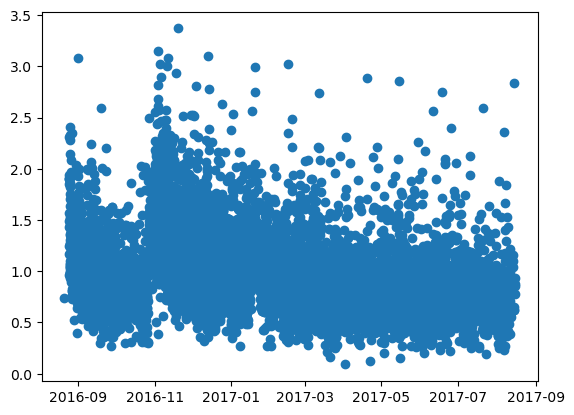

In [53]:
plt.plot(result_base['time'],result_base['Mw'],'o')
len(result_base)

In [54]:
estimate_b_classic(magnitudes=result_base.Mw.iloc[np.where(result_base.Mw>=1.09)],
    mc=1.09,
    delta_m=0.01)

1.4788734975948936

In [55]:
interval

0.01

100%|█████████████████████████████████████████████| 327/327 [00:07<00:00, 42.40it/s]
n_compl 4250
Mc-Lilliefors: 1.09
   --> number of events ≥ Mc-Lilliefors: 4250
1.09 3.39 0.09 3.39

    b-value: 1.47873
    95% conf int: [1.52281, 1.43637]
3.615002614524588 3.615002614524588
eli_b_value_mle= 1.4787306105502502


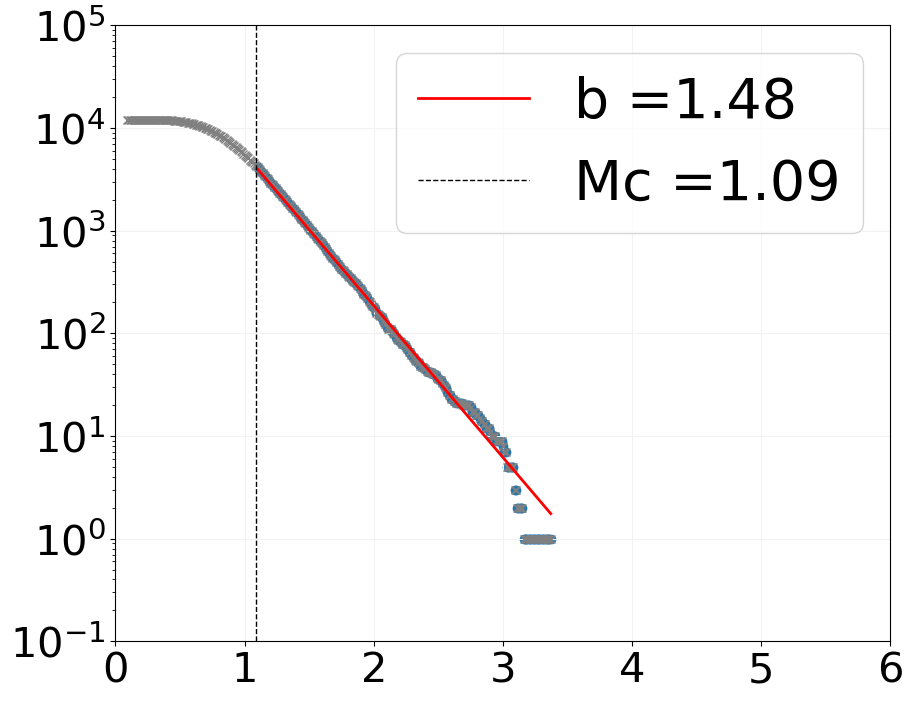

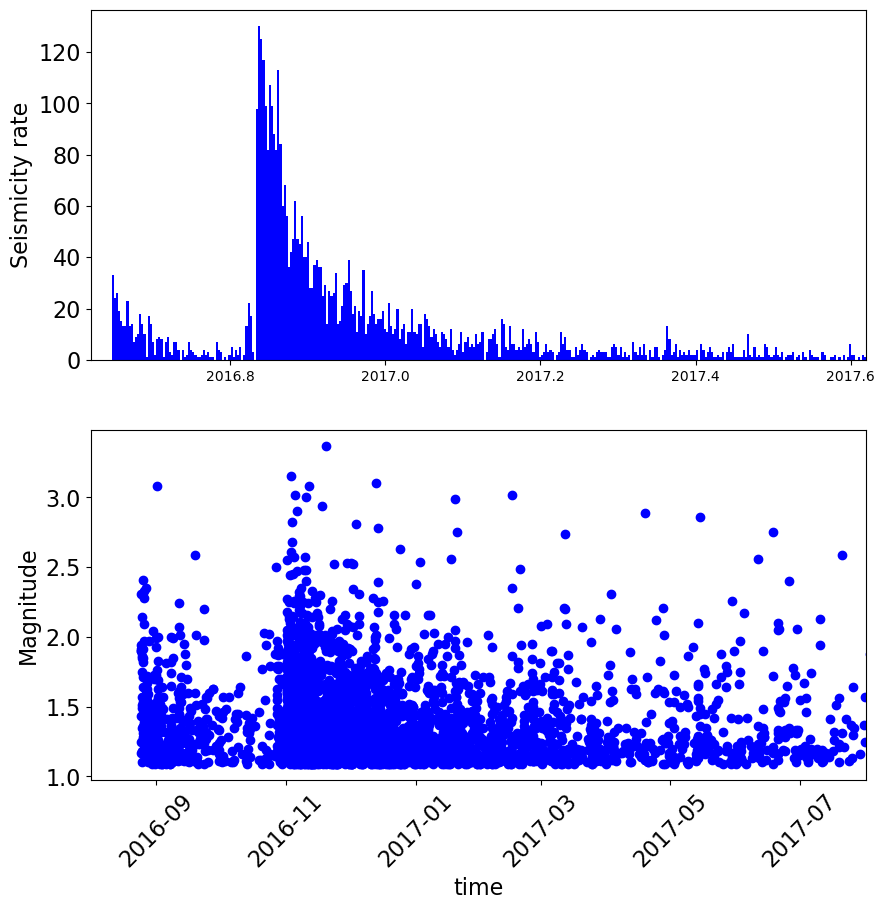

In [56]:
outputBASE=compute_b_value(result_base,interval)

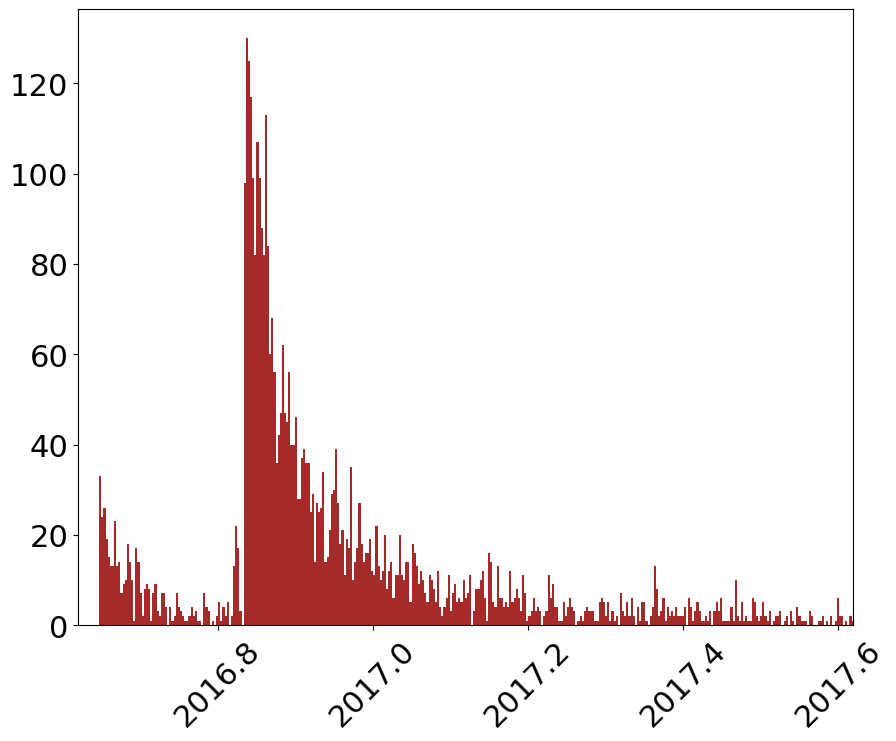

In [57]:

Mmin=outputBASE[1]
colore='brown'
plot_histo_selection(result_base, Mmin, colore)


In [58]:
#import seis_utils
#a_t_decYr = seis_utils.dateTime2decYr( [2016, 8,15,0,0,0])
#print(a_t_decYr)
#a_t_decYr = seis_utils.dateTime2decYr( [2017, 8,15,0,0,0])
#print(a_t_decYr)

In [59]:
#plt.plot(result_base.time,result_base.Mw )
#plt.xlim(pd.to_datetime('2016-08-1'),pd.to_datetime('2017-08-1'))

In [60]:
!mv b_value_plot.pdf b_basementTAN_Mw.pdf
!mv seismicity_rate_subset.pdf seismicity_rate_subset_basementTAN_Mw.pdf

In [61]:
B_value5[4]=outputBASE[0]


In [62]:
outputBASE

(1.4787306105502502,
 1.09,
 4250,
 1.5228093658689867,
 1.4363713497084183,
 0.022177617407050973)

In [63]:
Bpositive_5Mw[4],STD_positive[4]=estimate_b_positive(result_base['Mw'],interval,dmc=dmc_value,return_std = True)


### b value for Deep Carbonates

In [64]:
minC=4.3
maxC=5.9

In [65]:
am_PREcarb=am_PRE[(am_PRE['depth'] >= minC)&(am_PRE['depth'] <= maxC)]
am_PREcarb= am_PREcarb.reset_index(drop=True)
am_POSTcarb=am_POST[(am_POST['depth'] >= minC)&(am_POST['depth'] <= maxC)]
am_POSTcarb= am_POSTcarb.reset_index(drop=True)


In [66]:
utmx_PREcarb,utmy_PREcarb=utm33(np.array(am_PREcarb['lon']),np.array(am_PREcarb['lat']))   # 1 day pre M 6.5
utmx_POSTcarb,utmy_POSTcarb=utm33(np.array(am_POSTcarb['lon']),np.array(am_POSTcarb['lat']))   # 1 day pre M 6.5


In [67]:
dist_refPOSTcarb=distance_point_from_plane_pos_neg(utmx_POSTcarb/1000,utmy_POSTcarb/1000, -am_POSTcarb['depth'], normal_ref, mainev_ref)
#distance reference point
dist_refPREcarb=distance_point_from_plane_pos_neg(utmx_PREcarb/1000,utmy_PREcarb/1000, -am_PREcarb['depth'], normal_ref, mainev_ref)

# DISTANCE ALONG STRIKE
loo=-6
laa=+6

distPREcarb = np.where((dist_refPREcarb>loo)&(dist_refPREcarb<laa))
distPOSTcarb = np.where((dist_refPOSTcarb>loo)&(dist_refPOSTcarb<laa))

result_catal = np.where((distam_ref >loo)&(distam_ref <laa))
X_onsection_catal=+(utmy_am[result_catal]/1000-mainev_ref[1])*normal_ref[0]-(utmx_am[result_catal]/1000-mainev_ref[0])*normal_ref[1]


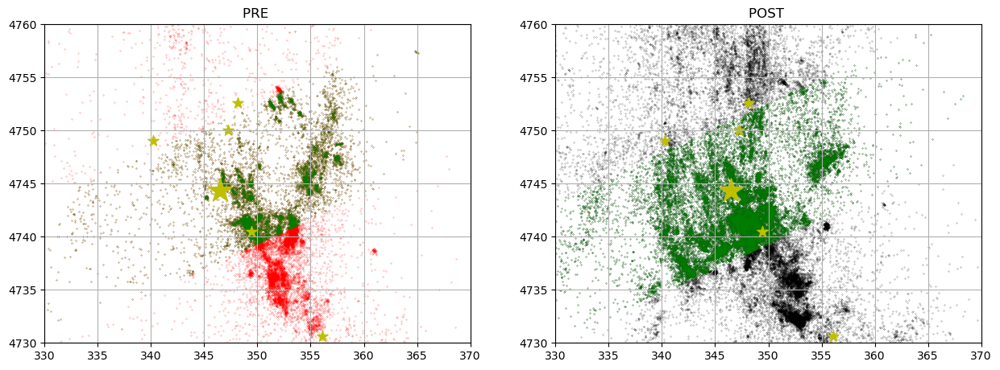

In [68]:
#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PREcarb/1000, utmy_PREcarb/1000,s=0.1,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTcarb/1000, utmy_POSTcarb/1000,s=0.1,marker='.', c='k', label='Tan et al., 2021')

axs[0].scatter(utmx_PREcarb[distPREcarb]/1000, utmy_PREcarb[distPREcarb]/1000,s=0.1,marker='.', c='g', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTcarb[distPOSTcarb]/1000, utmy_POSTcarb[distPOSTcarb]/1000,s=0.1,marker='.', c='g', label='Tan et al., 2021')

axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')


axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE ')
axs[1].set_title('POST ')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()

In [69]:
am_PREcarb_sel=am_PREcarb.loc[distPREcarb]
am_PREcarb_sel= am_PREcarb_sel.reset_index(drop=True)
utmx_PREcarb_sel,utmy_PREcarb_sel=utm33(np.array(am_PREcarb_sel['lon']),np.array(am_PREcarb_sel['lat']))   # 1 day pre M 6.5
X_onsection_PREcarb_sel=+(utmy_PREcarb_sel/1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_PREcarb_sel/1000-mainev_ref[0])*normal_ref_vertical[1]
am_POSTcarb_sel=am_POSTcarb.loc[distPOSTcarb]
am_POSTcarb_sel= am_POSTcarb_sel.reset_index(drop=True)
utmx_POSTcarb_sel,utmy_POSTcarb_sel=utm33(np.array(am_POSTcarb_sel['lon']),np.array(am_POSTcarb_sel['lat']))   # 1 day pre M 6.5
X_onsection_POSTcarb_sel=+(utmy_POSTcarb_sel/1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_POSTcarb_sel/1000-mainev_ref[0])*normal_ref_vertical[1]


Text(0.5, 1.0, ' ')

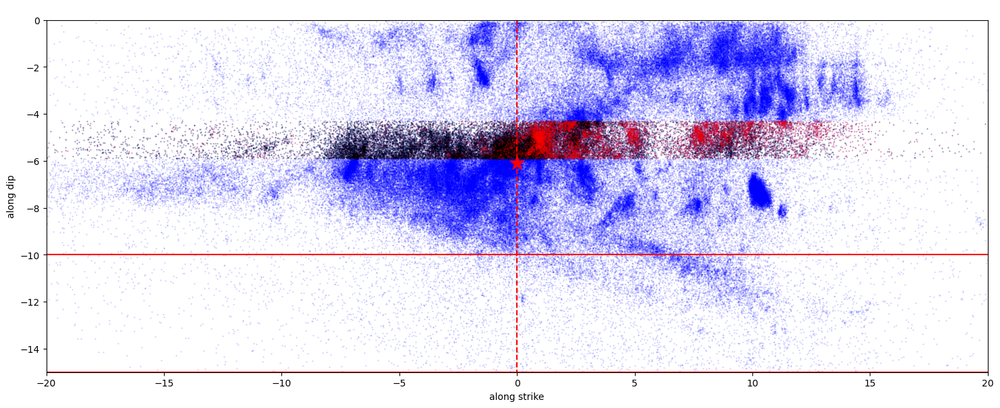

In [70]:
%matplotlib inline

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(18, 10))

ax.scatter( X_onsection_catal,(-am['depth'].loc[result_catal])/np.sin(dip_angle*np.pi/180),c='b',s=1,marker='.',alpha=.2,label='x')
ax.scatter(X_onsection_POSTcarb_sel,(-am_POSTcarb_sel['depth'])/np.sin(dip_angle*np.pi/180),c='k',s=2,marker='.',alpha=.2,label='x')
ax.scatter(X_onsection_PREcarb_sel,(-am_PREcarb_sel['depth'])/np.sin(dip_angle*np.pi/180),c='r',s=2,marker='.',alpha=.2,label='x')

ax.scatter(fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180), marker='*', c='r',s=250, label='Mw 6.5')
ax.plot([-20,20],[-15.0, -15.0],'r')
#ax.plot([-20,20],[-9.5, -9.5],'r--')
#ax.plot([-20,20],[-12.5, -12.5],'r--')
ax.plot([-20,20],[-10., -10.],'r')
ax.plot([0,0],[0, -15],'r--')
#ax.plot([16,16],[0, -15],'r--')
ax.set_ylim(-15,0)
ax.set_xlim(-20,20)
ax.set_aspect('equal', adjustable='box')
ax.set_ylabel('along dip')
ax.set_xlabel('along strike')
ax.set_title(' ')

In [71]:
# DISTANCE ORTHOGONAL TO STRIKE

Xmin=7
Xmax=+12

where_PREcarb_sel = ((X_onsection_PREcarb_sel<Xmax) &(X_onsection_PREcarb_sel>Xmin))
where_POSTcarb_sel = ((X_onsection_POSTcarb_sel<Xmax) &(X_onsection_POSTcarb_sel>Xmin))

In [72]:

am_POSTcarb_sel_box=am_POSTcarb_sel.loc[where_POSTcarb_sel]
am_POSTcarb_sel_box= am_POSTcarb_sel_box.reset_index(drop=True)
print(len(am_POSTcarb_sel_box))
am_PREcarb_sel_box=am_PREcarb_sel.loc[where_PREcarb_sel]
am_PREcarb_sel_box= am_PREcarb_sel_box.reset_index(drop=True)
print(len(am_PREcarb_sel_box))

2631
3024


In [73]:

utmx_PREcarb_sel_box,utmy_PREcarb_sel_box=utm33(np.array(am_PREcarb_sel_box['lon']),np.array(am_PREcarb_sel_box['lat']))   # 1 day pre M 6.5
utmx_POSTcarb_sel_box,utmy_POSTcarb_sel_box=utm33(np.array(am_POSTcarb_sel_box['lon']),np.array(am_POSTcarb_sel_box['lat']))   # 1 day pre M 6.5
print(len(utmx_POSTcarb_sel_box))


2631


In [74]:
X_on_PREcarb_sel_box=+(utmy_PREcarb_sel_box/1000-mainev_ref[1])*normal_ref[0]-(utmx_PREcarb_sel_box/1000-mainev_ref[0])*normal_ref[1]
X_on_POSTcarb_sel_box=+(utmy_POSTcarb_sel_box/1000-mainev_ref[1])*normal_ref[0]-(utmx_POSTcarb_sel_box/1000-mainev_ref[0])*normal_ref[1]


Text(0.5, 1.0, ' ')

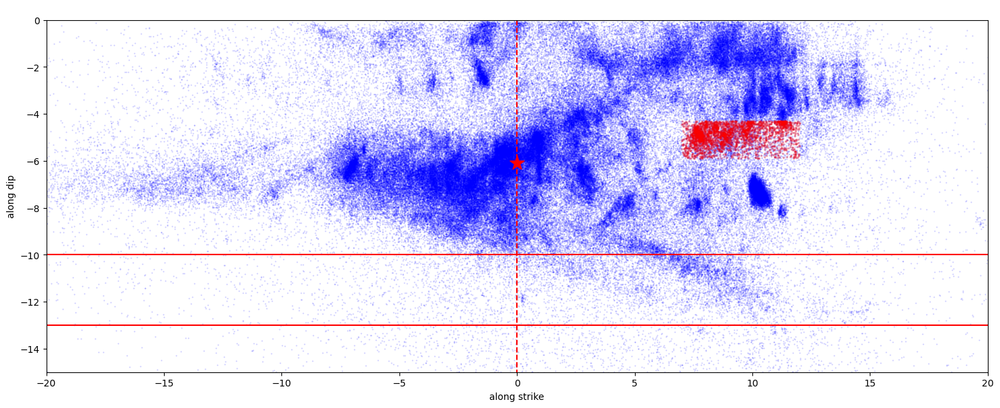

In [75]:
%matplotlib inline

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(18, 10))

ax.scatter( X_onsection_catal,(-am['depth'].loc[result_catal])/np.sin(dip_angle*np.pi/180),c='b',s=1,marker='.',alpha=.2,label='x')
#ax.scatter(X_on_POSTcarb_sel_box,(-am_POSTcarb_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='k',s=10,marker='.',alpha=.2,label='x')
ax.scatter(X_on_PREcarb_sel_box,(-am_PREcarb_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='r',s=10,marker='.',alpha=.2,label='x')

ax.scatter(fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180), marker='*', c='r',s=250, label='Mw 6.5')
ax.plot([-20,20],[-13.0, -13.0],'r')
#ax.plot([-20,20],[-9.5, -9.5],'r--')
#ax.plot([-20,20],[-12.5, -12.5],'r--')
ax.plot([-20,20],[-10., -10.],'r')
ax.plot([0,0],[0, -15],'r--')
#ax.plot([16,16],[0, -15],'r--')
ax.set_ylim(-15,0)
ax.set_xlim(-20,20)
ax.set_aspect('equal', adjustable='box')
ax.set_ylabel('along dip')
ax.set_xlabel('along strike')
ax.set_title(' ')


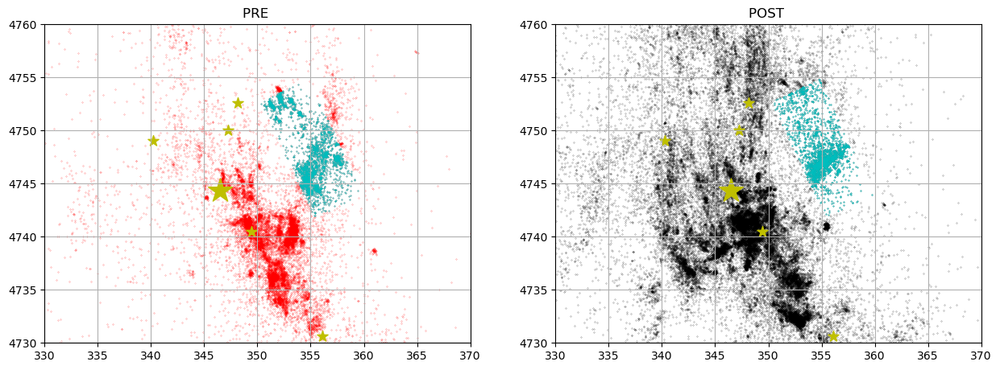

In [76]:
#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PREcarb/1000, utmy_PREcarb/1000,s=0.1,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTcarb/1000, utmy_POSTcarb/1000,s=0.1,marker='.', c='k', label='Tan et al., 2021')


axs[0].scatter(utmx_PREcarb_sel_box/1000, utmy_PREcarb_sel_box/1000,s=0.5,marker='.', c='c', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTcarb_sel_box/1000, utmy_POSTcarb_sel_box/1000,s=0.5,marker='.', c='c', label='Tan et al., 2021')


axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')


axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE ')
axs[1].set_title('POST ')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()

In [77]:
frames = [am_PREcarb_sel_box, am_POSTcarb_sel_box]
#frames = [ am_POSTs_sel_box]
#frames = [ am_PREs_sel_box]

deepcarbo = pd.concat(frames)
deepcarbo=deepcarbo.reset_index(drop=True)
print(len(deepcarbo))

5655


100%|█████████████████████████████████████████████| 305/305 [00:04<00:00, 75.37it/s]
n_compl 1660
Mc-Lilliefors: 1.01
   --> number of events ≥ Mc-Lilliefors: 1660
1.01 3.16 -0.05 3.16

    b-value: 1.43363
    95% conf int: [1.50250, 1.36949]
3.2079035303860515 3.2079035303860515
eli_b_value_mle= 1.4336286514594192


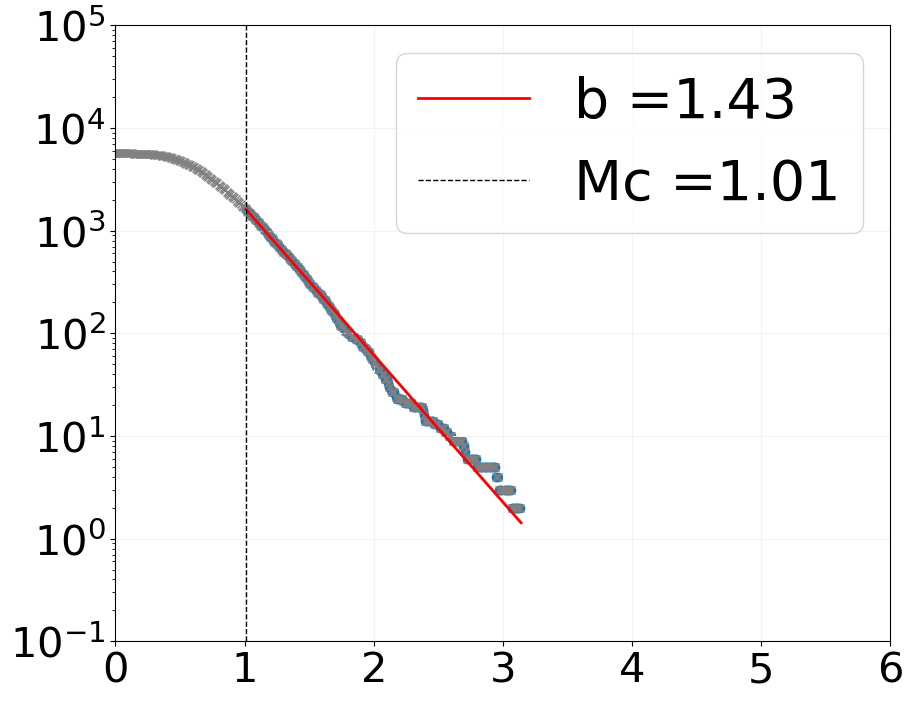

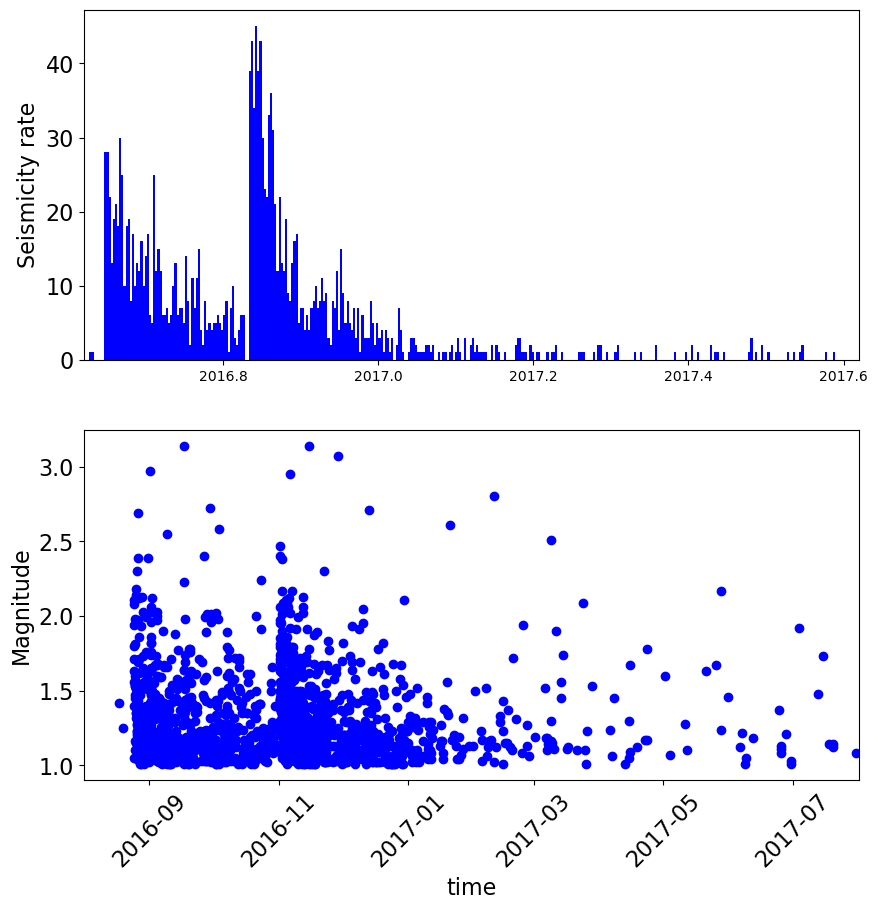

In [78]:
outputDEEPCA=compute_b_value(deepcarbo,interval)

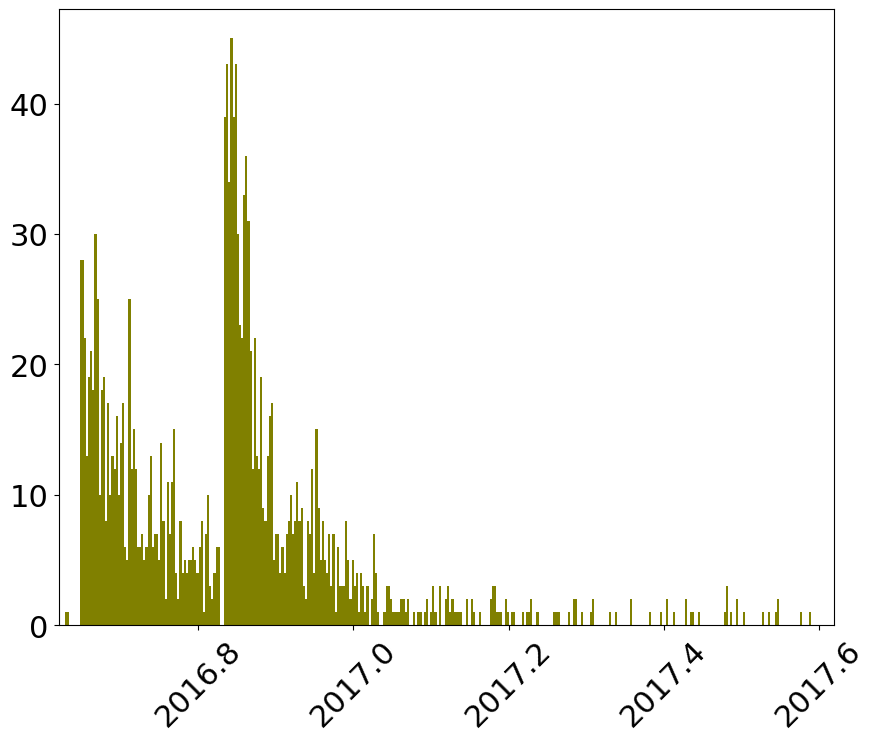

In [79]:

Mmin=outputDEEPCA[1]
colore='olive'
plot_histo_selection(deepcarbo, Mmin, colore)

In [80]:
!mv seismicity_rate_subset.pdf seismicity_rate_subset_deepcarbo_Tan_Mw.pdf
!mv b_value_plot.pdf b_deepcarbo_Tan_Mw.pdf

In [81]:
B_value5[2]=outputDEEPCA[0]

In [82]:
Bpositive_5Mw[2],STD_positive[2]=estimate_b_positive(deepcarbo['Mw'],interval,dmc=dmc_value,return_std=True)
#Bpositive_5Mw[2],STD_positive[2]=estimate_b_more_positive(deepcarbo['Mw'],interval,dmc=dmc_value,return_std=True)

print(Bpositive_5Mw[2],STD_positive[2])

1.357333465824918 0.023663649528014346


### b value for Shallow Carbonates

In [83]:
minCs=0
maxCs=1.8

In [84]:
am_PREcarbS=am_PRE[(am_PRE['depth'] >= minCs)&(am_PRE['depth'] <= maxCs)]
am_PREcarbS= am_PREcarbS.reset_index(drop=True)
am_POSTcarbS=am_POST[(am_POST['depth'] >= minCs)&(am_POST['depth'] <= maxCs)]
am_POSTcarbS= am_POSTcarbS.reset_index(drop=True)


In [85]:
utmx_PREcarbS,utmy_PREcarbS=utm33(np.array(am_PREcarbS['lon']),np.array(am_PREcarbS['lat']))   # 1 day pre M 6.5
utmx_POSTcarbS,utmy_POSTcarbS=utm33(np.array(am_POSTcarbS['lon']),np.array(am_POSTcarbS['lat']))   # 1 day pre M 6.5


In [86]:
dist_refPOSTcarbS=distance_point_from_plane_pos_neg(utmx_POSTcarbS/1000,utmy_POSTcarbS/1000, -am_POSTcarbS['depth'], normal_ref, mainev_ref)
#distance reference point
dist_refPREcarbS=distance_point_from_plane_pos_neg(utmx_PREcarbS/1000,utmy_PREcarbS/1000, -am_PREcarbS['depth'], normal_ref, mainev_ref)

# DISTANCE ALONG STRIKE
loo=-6
laa=+6

distPREcarbS = np.where((dist_refPREcarbS>loo)&(dist_refPREcarbS<laa))
distPOSTcarbS = np.where((dist_refPOSTcarbS>loo)&(dist_refPOSTcarbS<laa))

result_catal = np.where((distam_ref >loo)&(distam_ref <laa))
X_onsection_catal=+(utmy_am[result_catal]/1000-mainev_ref[1])*normal_ref[0]-(utmx_am[result_catal]/1000-mainev_ref[0])*normal_ref[1]


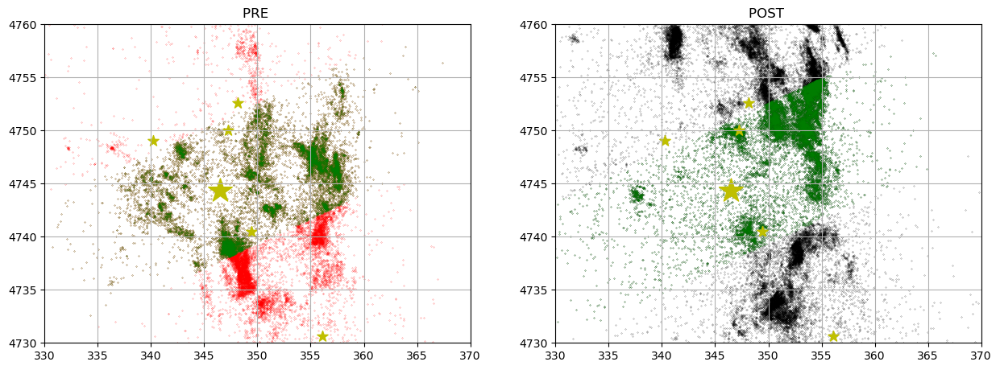

In [87]:
#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PREcarbS/1000, utmy_PREcarbS/1000,s=0.1,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTcarbS/1000, utmy_POSTcarbS/1000,s=0.1,marker='.', c='k', label='Tan et al., 2021')

axs[0].scatter(utmx_PREcarbS[distPREcarbS]/1000, utmy_PREcarbS[distPREcarbS]/1000,s=0.1,marker='.', c='g', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTcarbS[distPOSTcarbS]/1000, utmy_POSTcarbS[distPOSTcarbS]/1000,s=0.1,marker='.', c='g', label='Tan et al., 2021')

axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')


axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE ')
axs[1].set_title('POST ')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()

In [88]:
am_PREcarbS_sel=am_PREcarbS.loc[distPREcarbS]
am_PREcarbS_sel= am_PREcarbS_sel.reset_index(drop=True)
utmx_PREcarbS_sel,utmy_PREcarbS_sel=utm33(np.array(am_PREcarbS_sel['lon']),np.array(am_PREcarbS_sel['lat']))   # 1 day pre M 6.5
X_onsection_PREcarbS_sel=+(utmy_PREcarbS_sel/1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_PREcarbS_sel/1000-mainev_ref[0])*normal_ref_vertical[1]
am_POSTcarbS_sel=am_POSTcarbS.loc[distPOSTcarbS]
am_POSTcarbS_sel= am_POSTcarbS_sel.reset_index(drop=True)
utmx_POSTcarbS_sel,utmy_POSTcarbS_sel=utm33(np.array(am_POSTcarbS_sel['lon']),np.array(am_POSTcarbS_sel['lat']))   # 1 day pre M 6.5
X_onsection_POSTcarbS_sel=+(utmy_POSTcarbS_sel/1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_POSTcarbS_sel/1000-mainev_ref[0])*normal_ref_vertical[1]


Text(0.5, 1.0, ' ')

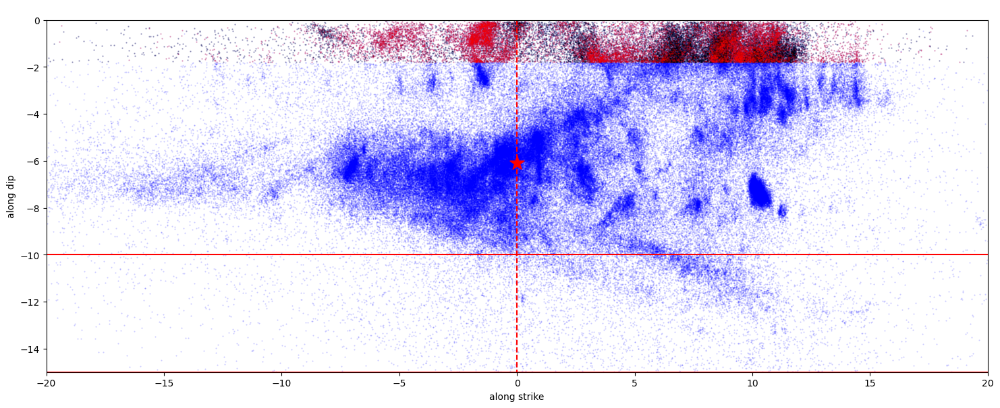

In [89]:
%matplotlib inline

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(18, 10))

ax.scatter( X_onsection_catal,(-am['depth'].loc[result_catal])/np.sin(dip_angle*np.pi/180),c='b',s=1,marker='.',alpha=.2,label='x')
ax.scatter(X_onsection_POSTcarbS_sel,(-am_POSTcarbS_sel['depth'])/np.sin(dip_angle*np.pi/180),c='k',s=2,marker='.',alpha=.2,label='x')
ax.scatter(X_onsection_PREcarbS_sel,(-am_PREcarbS_sel['depth'])/np.sin(dip_angle*np.pi/180),c='r',s=2,marker='.',alpha=.2,label='x')

ax.scatter(fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180), marker='*', c='r',s=250, label='Mw 6.5')
ax.plot([-20,20],[-15.0, -15.0],'r')
#ax.plot([-20,20],[-9.5, -9.5],'r--')
#ax.plot([-20,20],[-12.5, -12.5],'r--')
ax.plot([-20,20],[-10., -10.],'r')
ax.plot([0,0],[0, -15],'r--')
#ax.plot([16,16],[0, -15],'r--')
ax.set_ylim(-15,0)
ax.set_xlim(-20,20)
ax.set_aspect('equal', adjustable='box')
ax.set_ylabel('along dip')
ax.set_xlabel('along strike')
ax.set_title(' ')

In [90]:
# DISTANCE ORTHOGONAL TO STRIKE

Xmin=8

Xmax=+12

where_PREcarbS_sel = ((X_onsection_PREcarbS_sel<Xmax) &(X_onsection_PREcarbS_sel>Xmin))
where_POSTcarbS_sel = ((X_onsection_POSTcarbS_sel<Xmax) &(X_onsection_POSTcarbS_sel>Xmin))

In [91]:

am_POSTcarbS_sel_box=am_POSTcarbS_sel.loc[where_POSTcarbS_sel]
am_POSTcarbS_sel_box= am_POSTcarbS_sel_box.reset_index(drop=True)
print(len(am_POSTcarbS_sel_box))
#am_POST_sel=am_POST.copy() #am_poM1.copy()
am_PREcarbS_sel_box=am_PREcarbS_sel.loc[where_PREcarbS_sel]
am_PREcarbS_sel_box= am_PREcarbS_sel_box.reset_index(drop=True)
print(len(am_PREcarbS_sel_box))

7294
4998


In [92]:

utmx_PREcarbS_sel_box,utmy_PREcarbS_sel_box=utm33(np.array(am_PREcarbS_sel_box['lon']),np.array(am_PREcarbS_sel_box['lat']))   # 1 day pre M 6.5
utmx_POSTcarbS_sel_box,utmy_POSTcarbS_sel_box=utm33(np.array(am_POSTcarbS_sel_box['lon']),np.array(am_POSTcarbS_sel_box['lat']))   # 1 day pre M 6.5
print(len(utmx_POSTcarbS_sel_box))


7294


In [93]:
X_on_PREcarbS_sel_box=+(utmy_PREcarbS_sel_box/1000-mainev_ref[1])*normal_ref[0]-(utmx_PREcarbS_sel_box/1000-mainev_ref[0])*normal_ref[1]
X_on_POSTcarbS_sel_box=+(utmy_POSTcarbS_sel_box/1000-mainev_ref[1])*normal_ref[0]-(utmx_POSTcarbS_sel_box/1000-mainev_ref[0])*normal_ref[1]


Text(0.5, 1.0, ' ')

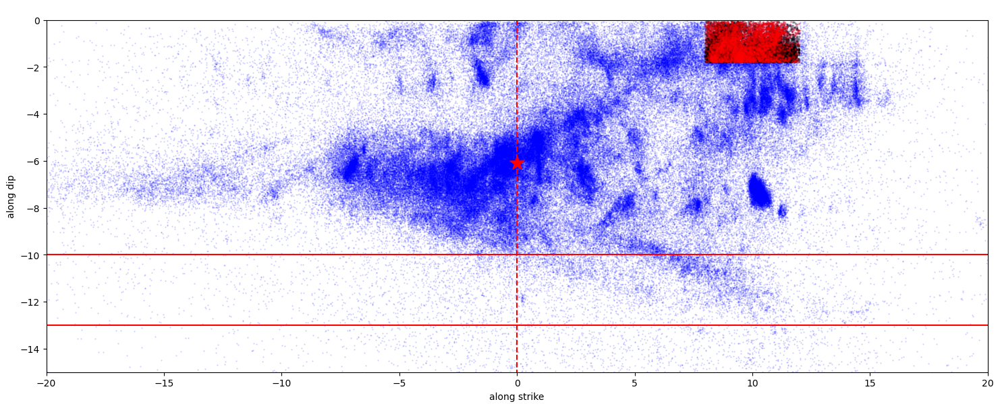

In [94]:
%matplotlib inline

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(18, 10))

ax.scatter( X_onsection_catal,(-am['depth'].loc[result_catal])/np.sin(dip_angle*np.pi/180),c='b',s=1,marker='.',alpha=.2,label='x')
ax.scatter(X_on_POSTcarbS_sel_box,(-am_POSTcarbS_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='k',s=10,marker='.',alpha=.2,label='x')
ax.scatter(X_on_PREcarbS_sel_box,(-am_PREcarbS_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='r',s=10,marker='.',alpha=.2,label='x')

ax.scatter(fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180), marker='*', c='r',s=250, label='Mw 6.5')
ax.plot([-20,20],[-13.0, -13.0],'r')
#ax.plot([-20,20],[-9.5, -9.5],'r--')
#ax.plot([-20,20],[-12.5, -12.5],'r--')
ax.plot([-20,20],[-10., -10.],'r')
ax.plot([0,0],[0, -15],'r--')
#ax.plot([16,16],[0, -15],'r--')
ax.set_ylim(-15,0)
ax.set_xlim(-20,20)
ax.set_aspect('equal', adjustable='box')
ax.set_ylabel('along dip')
ax.set_xlabel('along strike')
ax.set_title(' ')


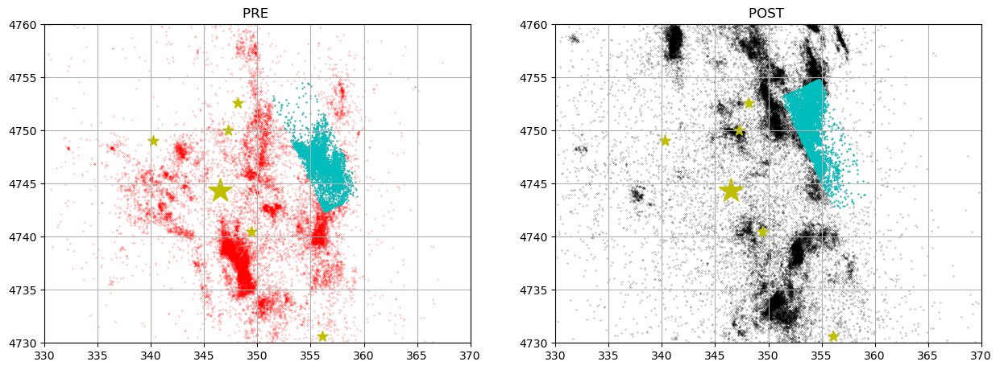

In [95]:
#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PREcarbS/1000, utmy_PREcarbS/1000,s=0.1,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTcarbS/1000, utmy_POSTcarbS/1000,s=0.1,marker='.', c='k', label='Tan et al., 2021')


axs[0].scatter(utmx_PREcarbS_sel_box/1000, utmy_PREcarbS_sel_box/1000,s=1,marker='.', c='c', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTcarbS_sel_box/1000, utmy_POSTcarbS_sel_box/1000,s=1,marker='.', c='c', label='Tan et al., 2021')


axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')


axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE ')
axs[1].set_title('POST ')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()

In [96]:
frames = [am_PREcarbS_sel_box, am_POSTcarbS_sel_box]

shallowcarbo = pd.concat(frames)
shallowcarbo=shallowcarbo.reset_index(drop=True)
print(len(shallowcarbo))

12292


100%|█████████████████████████████████████████████| 371/371 [00:07<00:00, 47.63it/s]
n_compl 2824
Mc-Lilliefors: 1.24
   --> number of events ≥ Mc-Lilliefors: 2824
1.24 3.83 -0.08 3.83

    b-value: 1.34721
    95% conf int: [1.39843, 1.29874]
3.4382258076045296 3.4382258076045296
eli_b_value_mle= 1.3472116710914184


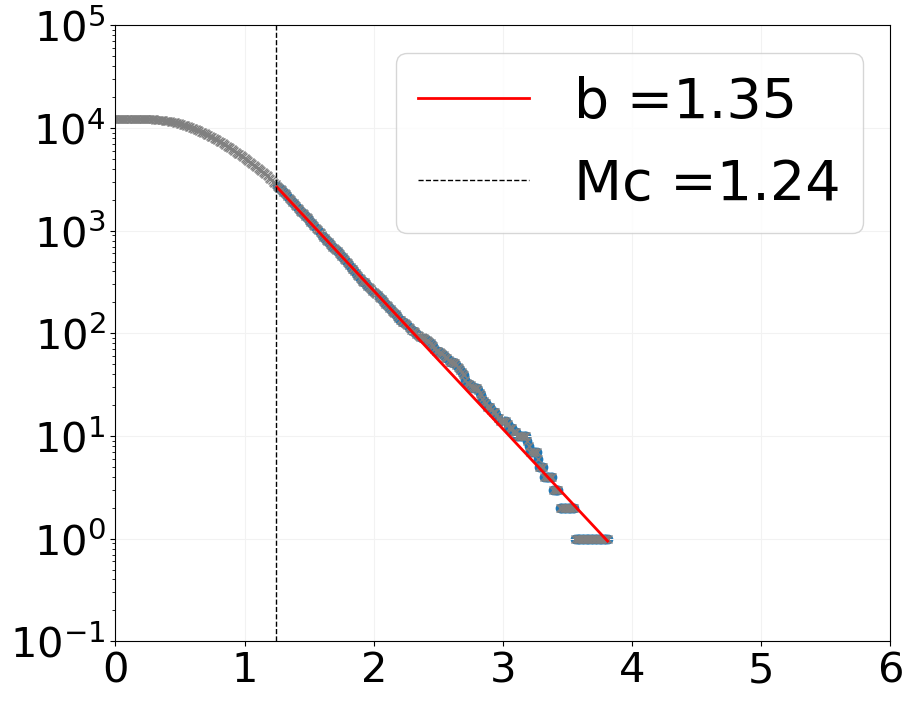

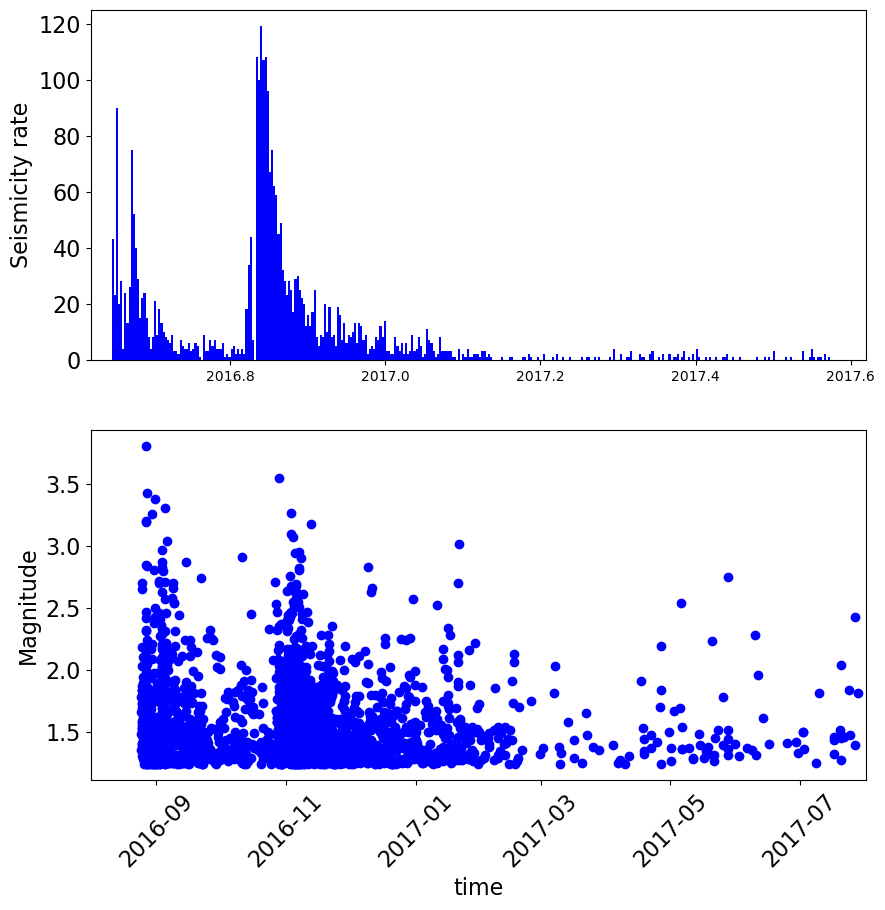

In [97]:
outputSHACA=compute_b_value(shallowcarbo,interval)

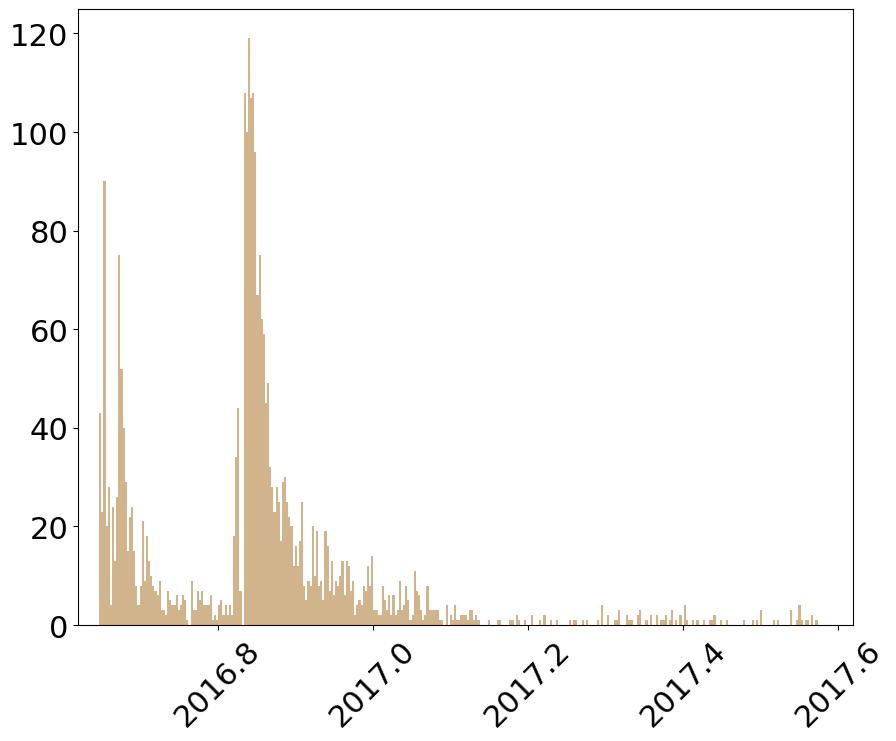

In [98]:

Mmin=outputSHACA[1]
colore='tan'
plot_histo_selection(shallowcarbo, Mmin, colore)

In [99]:
!mv seismicity_rate_subset.pdf seismicity_rate_subset_shallowcarbo_Tan_Mw.pdf
!mv b_value_plot.pdf b_shallowcarbo_Tan_Mw.pdf

In [100]:
B_value5[0]=outputSHACA[0]

In [101]:
Bpositive_5Mw[0],STD_positive[0]=estimate_b_positive(shallowcarbo['Mw'],interval,dmc=dmc_value,return_std=True)

print(Bpositive_5Mw[0],STD_positive[0])

1.2187544511279922 0.013991053070917523


### b value for Shallow Evaporites

In [103]:
minCe=2.0
maxCe=4.2

In [104]:
am_PREevaS=am_PRE[(am_PRE['depth'] >= minCe)&(am_PRE['depth'] <= maxCe)]
am_PREevaS= am_PREevaS.reset_index(drop=True)
am_POSTevaS=am_POST[(am_POST['depth'] >= minCe)&(am_POST['depth'] <= maxCe)]
am_POSTevaS= am_POSTevaS.reset_index(drop=True)


In [105]:
utmx_PREevaS,utmy_PREevaS=utm33(np.array(am_PREevaS['lon']),np.array(am_PREevaS['lat']))   # 1 day pre M 6.5
utmx_POSTevaS,utmy_POSTevaS=utm33(np.array(am_POSTevaS['lon']),np.array(am_POSTevaS['lat']))   # 1 day pre M 6.5


In [106]:
dist_refPOSTevaS=distance_point_from_plane_pos_neg(utmx_POSTevaS/1000,utmy_POSTevaS/1000, -am_POSTevaS['depth'], normal_ref, mainev_ref)
#distance reference point
dist_refPREevaS=distance_point_from_plane_pos_neg(utmx_PREevaS/1000,utmy_PREevaS/1000, -am_PREevaS['depth'], normal_ref, mainev_ref)

# DISTANCE ALONG STRIKE
loo=-6
laa=+6

distPREevaS = np.where((dist_refPREevaS>loo)&(dist_refPREevaS<laa))
distPOSTevaS = np.where((dist_refPOSTevaS>loo)&(dist_refPOSTevaS<laa))

result_catal = np.where((distam_ref >loo)&(distam_ref <laa))
X_onsection_catal=+(utmy_am[result_catal]/1000-mainev_ref[1])*normal_ref[0]-(utmx_am[result_catal]/1000-mainev_ref[0])*normal_ref[1]


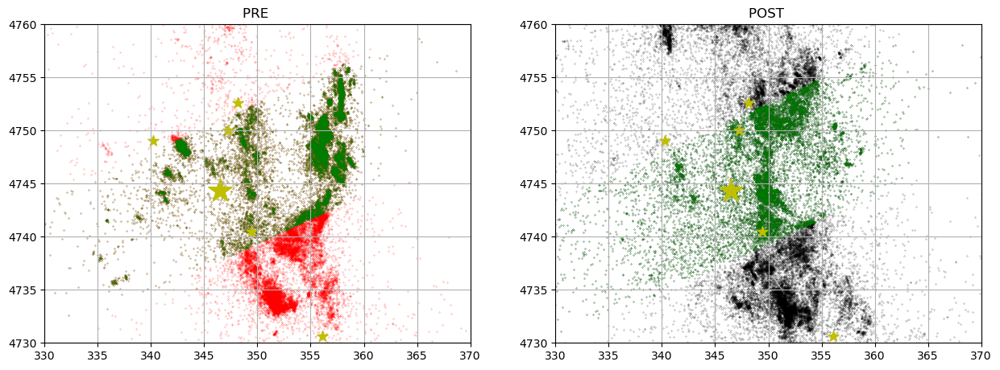

In [107]:
#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PREevaS/1000, utmy_PREevaS/1000,s=0.1,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTevaS/1000, utmy_POSTevaS/1000,s=0.1,marker='.', c='k', label='Tan et al., 2021')

axs[0].scatter(utmx_PREevaS[distPREevaS]/1000, utmy_PREevaS[distPREevaS]/1000,s=0.1,marker='.', c='g', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTevaS[distPOSTevaS]/1000, utmy_POSTevaS[distPOSTevaS]/1000,s=0.1,marker='.', c='g', label='Tan et al., 2021')

axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')


axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE ')
axs[1].set_title('POST ')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()

In [108]:
am_PREevaS_sel=am_PREevaS.loc[distPREevaS]
am_PREevaS_sel= am_PREevaS_sel.reset_index(drop=True)
utmx_PREevaS_sel,utmy_PREevaS_sel=utm33(np.array(am_PREevaS_sel['lon']),np.array(am_PREevaS_sel['lat']))   # 1 day pre M 6.5
X_onsection_PREevaS_sel=+(utmy_PREevaS_sel/1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_PREevaS_sel/1000-mainev_ref[0])*normal_ref_vertical[1]
am_POSTevaS_sel=am_POSTevaS.loc[distPOSTevaS]
am_POSTevaS_sel= am_POSTevaS_sel.reset_index(drop=True)
utmx_POSTevaS_sel,utmy_POSTevaS_sel=utm33(np.array(am_POSTevaS_sel['lon']),np.array(am_POSTevaS_sel['lat']))   # 1 day pre M 6.5
X_onsection_POSTevaS_sel=+(utmy_POSTevaS_sel/1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_POSTevaS_sel/1000-mainev_ref[0])*normal_ref_vertical[1]


Text(0.5, 1.0, ' ')

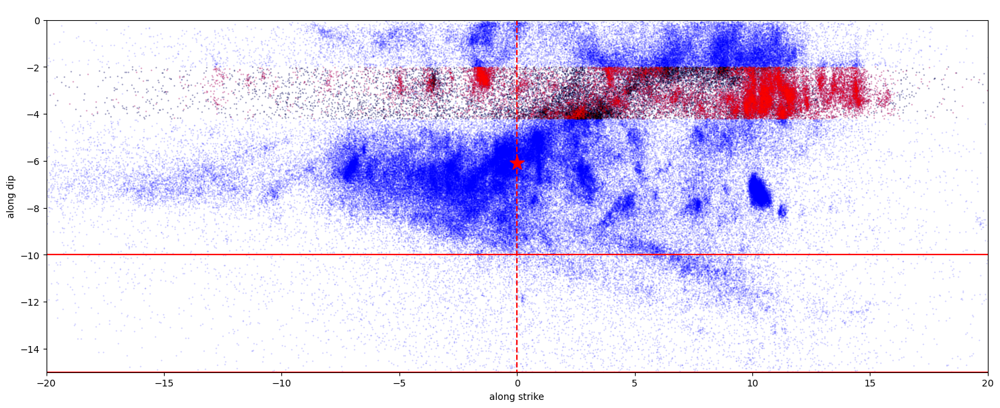

In [109]:
%matplotlib inline

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(18, 10))

ax.scatter( X_onsection_catal,(-am['depth'].loc[result_catal])/np.sin(dip_angle*np.pi/180),c='b',s=1,marker='.',alpha=.2,label='x')
ax.scatter(X_onsection_POSTevaS_sel,(-am_POSTevaS_sel['depth'])/np.sin(dip_angle*np.pi/180),c='k',s=2,marker='.',alpha=.2,label='x')
ax.scatter(X_onsection_PREevaS_sel,(-am_PREevaS_sel['depth'])/np.sin(dip_angle*np.pi/180),c='r',s=2,marker='.',alpha=.2,label='x')

ax.scatter(fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180), marker='*', c='r',s=250, label='Mw 6.5')
ax.plot([-20,20],[-15.0, -15.0],'r')
#ax.plot([-20,20],[-9.5, -9.5],'r--')
#ax.plot([-20,20],[-12.5, -12.5],'r--')
ax.plot([-20,20],[-10., -10.],'r')
ax.plot([0,0],[0, -15],'r--')
#ax.plot([16,16],[0, -15],'r--')
ax.set_ylim(-15,0)
ax.set_xlim(-20,20)
ax.set_aspect('equal', adjustable='box')
ax.set_ylabel('along dip')
ax.set_xlabel('along strike')
ax.set_title(' ')

In [110]:
# DISTANCE ORTHOGONAL TO STRIKE

Xmin=10.
Xmax=+12.0

where_PREevaS_sel = ((X_onsection_PREevaS_sel<Xmax) &(X_onsection_PREevaS_sel>Xmin))
where_POSTevaS_sel = ((X_onsection_POSTevaS_sel<Xmax) &(X_onsection_POSTevaS_sel>Xmin))

In [111]:

am_POSTevaS_sel_box=am_POSTevaS_sel.loc[where_POSTevaS_sel]
am_POSTevaS_sel_box= am_POSTevaS_sel_box.reset_index(drop=True)
print(len(am_POSTevaS_sel_box))
am_PREevaS_sel_box=am_PREevaS_sel.loc[where_PREevaS_sel]
am_PREevaS_sel_box= am_PREevaS_sel_box.reset_index(drop=True)
print(len(am_PREevaS_sel_box))

875
8426


In [112]:

utmx_PREevaS_sel_box,utmy_PREevaS_sel_box=utm33(np.array(am_PREevaS_sel_box['lon']),np.array(am_PREevaS_sel_box['lat']))   # 1 day pre M 6.5
utmx_POSTevaS_sel_box,utmy_POSTevaS_sel_box=utm33(np.array(am_POSTevaS_sel_box['lon']),np.array(am_POSTevaS_sel_box['lat']))   # 1 day pre M 6.5
print(len(utmx_POSTevaS_sel_box))


875


In [113]:
X_on_PREevaS_sel_box=+(utmy_PREevaS_sel_box/1000-mainev_ref[1])*normal_ref[0]-(utmx_PREevaS_sel_box/1000-mainev_ref[0])*normal_ref[1]
X_on_POSTevaS_sel_box=+(utmy_POSTevaS_sel_box/1000-mainev_ref[1])*normal_ref[0]-(utmx_POSTevaS_sel_box/1000-mainev_ref[0])*normal_ref[1]


Text(0.5, 1.0, ' ')

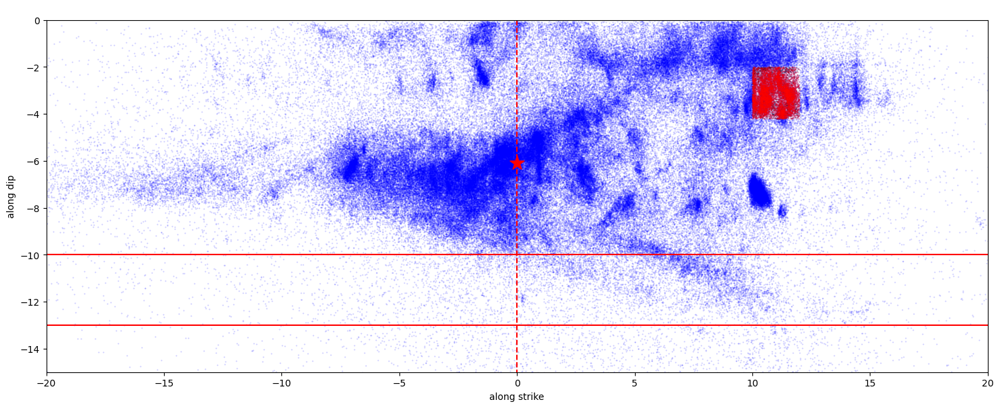

In [114]:
%matplotlib inline

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(18, 10))

ax.scatter( X_onsection_catal,(-am['depth'].loc[result_catal])/np.sin(dip_angle*np.pi/180),c='b',s=1,marker='.',alpha=.2,label='x')
ax.scatter(X_on_POSTevaS_sel_box,(-am_POSTevaS_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='k',s=2,marker='.',alpha=.2,label='x')
ax.scatter(X_on_PREevaS_sel_box,(-am_PREevaS_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='r',s=2,marker='.',alpha=.2,label='x')

ax.scatter(fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180), marker='*', c='r',s=250, label='Mw 6.5')
ax.plot([-20,20],[-13.0, -13.0],'r')
#ax.plot([-20,20],[-9.5, -9.5],'r--')
#ax.plot([-20,20],[-12.5, -12.5],'r--')
ax.plot([-20,20],[-10., -10.],'r')
ax.plot([0,0],[0, -15],'r--')
#ax.plot([16,16],[0, -15],'r--')
ax.set_ylim(-15,0)
ax.set_xlim(-20,20)
ax.set_aspect('equal', adjustable='box')
ax.set_ylabel('along dip')
ax.set_xlabel('along strike')
ax.set_title(' ')


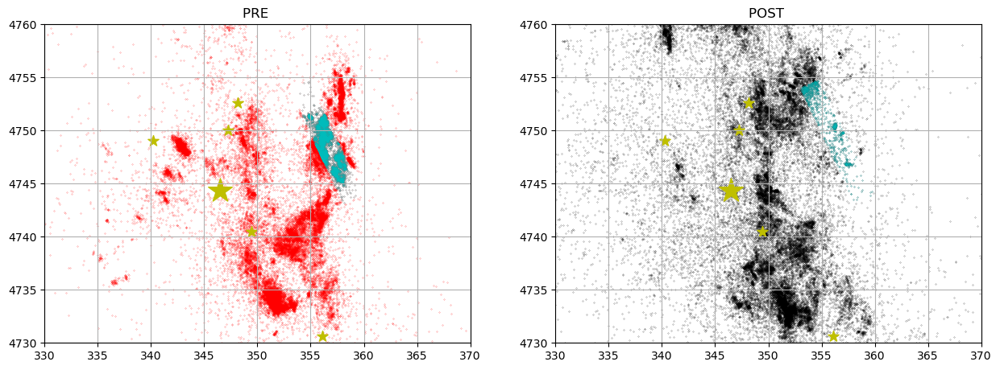

In [115]:
#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PREevaS/1000, utmy_PREevaS/1000,s=0.1,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTevaS/1000, utmy_POSTevaS/1000,s=0.1,marker='.', c='k', label='Tan et al., 2021')


axs[0].scatter(utmx_PREevaS_sel_box/1000, utmy_PREevaS_sel_box/1000,s=0.1,marker='.', c='c', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTevaS_sel_box/1000, utmy_POSTevaS_sel_box/1000,s=0.1,marker='.', c='c', label='Tan et al., 2021')


axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')


axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE ')
axs[1].set_title('POST ')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()

In [116]:
frames = [am_PREevaS_sel_box, am_POSTevaS_sel_box]

shalloweva = pd.concat(frames)
shalloweva=shalloweva.reset_index(drop=True)
print(len(shalloweva))

9301


100%|█████████████████████████████████████████████| 288/288 [00:04<00:00, 59.03it/s]
n_compl 2236
Mc-Lilliefors: 0.97
   --> number of events ≥ Mc-Lilliefors: 2236
0.97 2.99 -0.15 2.99

    b-value: 1.58167
    95% conf int: [1.64870, 1.51829]
3.3352572564345317 3.3352572564345317
eli_b_value_mle= 1.5816705673589013


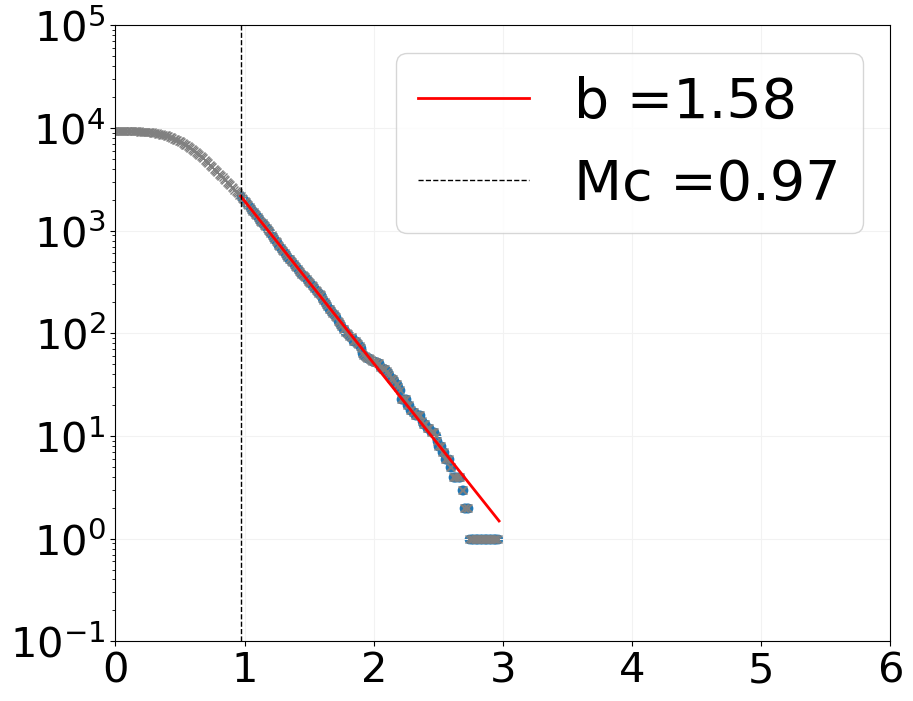

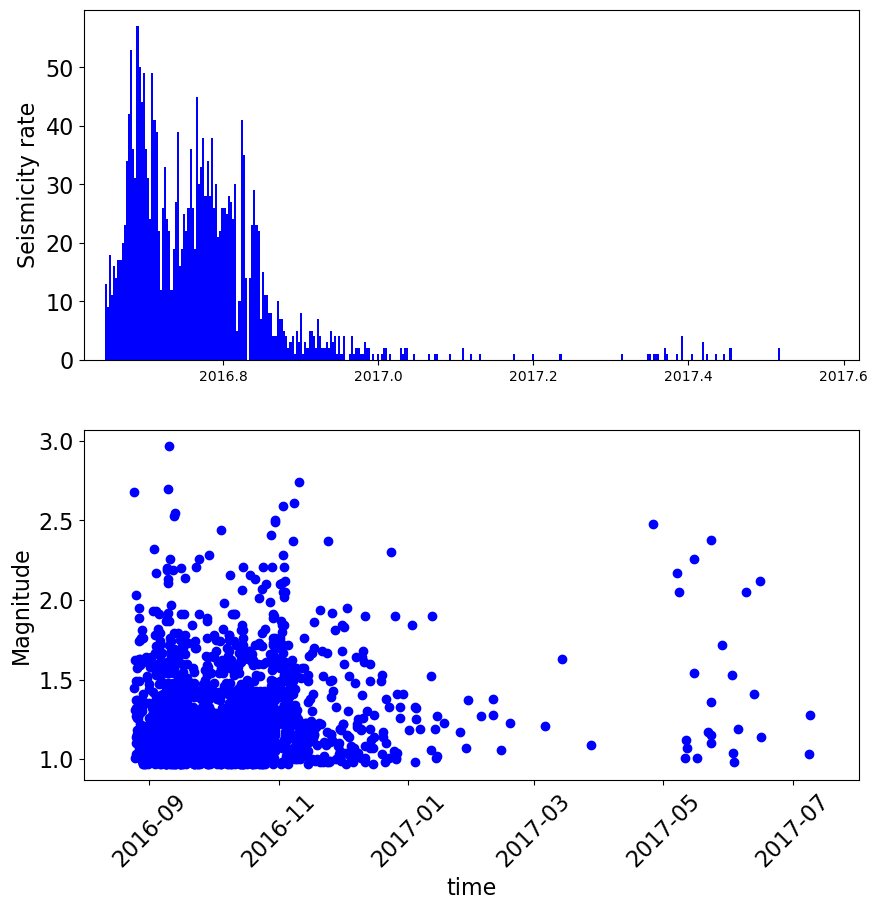

In [117]:
outputEVAS=compute_b_value(shalloweva,interval)

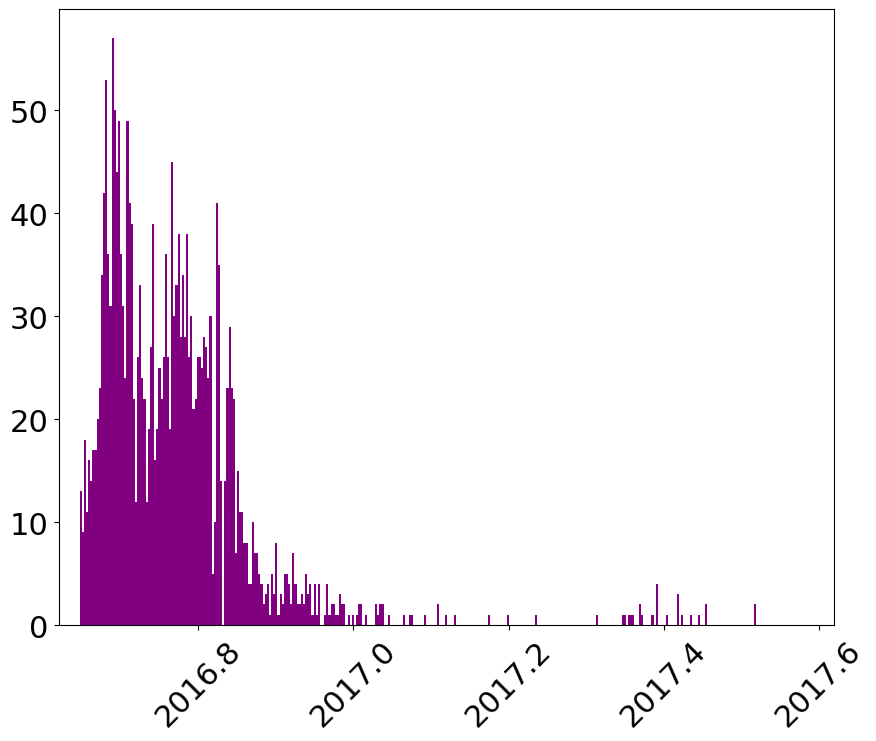

In [118]:

Mmin=outputEVAS[1]
colore='purple'
plot_histo_selection(shalloweva, Mmin, colore)

In [119]:
!mv b_value_plot.pdf b_shalloweva_Tan_Mw.pdf
!mv seismicity_rate_subset.pdf seismicity_rate_subset_b_shalloweva_Tan_Mw.pdf

In [120]:
B_value5[1]=outputEVAS[0]

In [121]:
np.size(outputEVAS[2])

1

In [122]:
Bpositive_5Mw[1],STD_positive[1]=estimate_b_positive(shalloweva['Mw'],interval,dmc=dmc_value,return_std=True)

print(Bpositive_5Mw[1],STD_positive[1])


1.3837878634715288 0.01791121254015938


### b value for Deep Evaporites

In [124]:
minCed=6.0
maxCed=9

In [125]:
am_PREevad=am_PRE[(am_PRE['depth'] >= minCed)&(am_PRE['depth'] <= maxCed)]
am_PREevad= am_PREevad.reset_index(drop=True)
am_POSTevad=am_POST[(am_POST['depth'] >= minCed)&(am_POST['depth'] <= maxCed)]
am_POSTevad= am_POSTevad.reset_index(drop=True)


In [126]:
utmx_PREevad,utmy_PREevad=utm33(np.array(am_PREevad['lon']),np.array(am_PREevad['lat']))   # 1 day pre M 6.5
utmx_POSTevad,utmy_POSTevad=utm33(np.array(am_POSTevad['lon']),np.array(am_POSTevad['lat']))   # 1 day pre M 6.5


In [127]:
dist_refPOSTevad=distance_point_from_plane_pos_neg(utmx_POSTevad/1000,utmy_POSTevad/1000, -am_POSTevad['depth'], normal_ref, mainev_ref)
#distance reference point
dist_refPREevad=distance_point_from_plane_pos_neg(utmx_PREevad/1000,utmy_PREevad/1000, -am_PREevad['depth'], normal_ref, mainev_ref)

# DISTANCE ALONG STRIKE
loo=-6
laa=+6

distPREevad = np.where((dist_refPREevad>loo)&(dist_refPREevad<laa))
distPOSTevad = np.where((dist_refPOSTevad>loo)&(dist_refPOSTevad<laa))

result_catal = np.where((distam_ref >loo)&(distam_ref <laa))
X_onsection_catal=+(utmy_am[result_catal]/1000-mainev_ref[1])*normal_ref[0]-(utmx_am[result_catal]/1000-mainev_ref[0])*normal_ref[1]


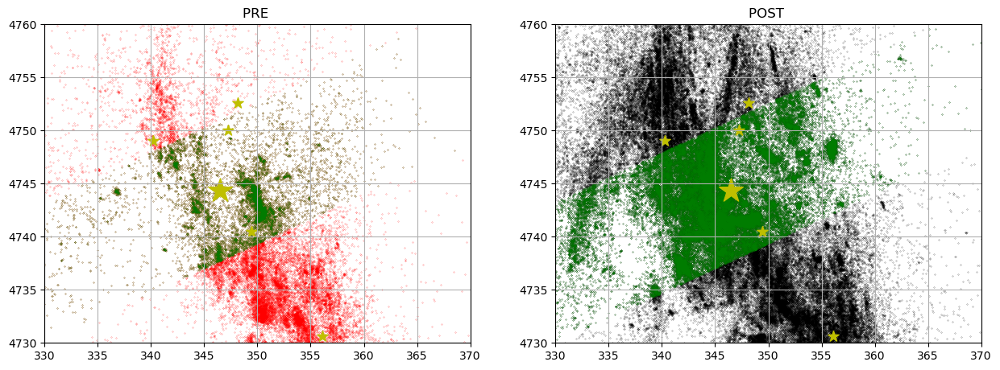

In [128]:
#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PREevad/1000, utmy_PREevad/1000,s=0.1,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTevad/1000, utmy_POSTevad/1000,s=0.1,marker='.', c='k', label='Tan et al., 2021')

axs[0].scatter(utmx_PREevad[distPREevad]/1000, utmy_PREevad[distPREevad]/1000,s=0.1,marker='.', c='g', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTevad[distPOSTevad]/1000, utmy_POSTevad[distPOSTevad]/1000,s=0.1,marker='.', c='g', label='Tan et al., 2021')

axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')


axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE ')
axs[1].set_title('POST ')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()

In [129]:
am_PREevad_sel=am_PREevad.loc[distPREevad]
am_PREevad_sel= am_PREevad_sel.reset_index(drop=True)
utmx_PREevad_sel,utmy_PREevad_sel=utm33(np.array(am_PREevad_sel['lon']),np.array(am_PREevad_sel['lat']))   # 1 day pre M 6.5
X_onsection_PREevad_sel=+(utmy_PREevad_sel/1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_PREevad_sel/1000-mainev_ref[0])*normal_ref_vertical[1]
am_POSTevad_sel=am_POSTevad.loc[distPOSTevad]
am_POSTevad_sel= am_POSTevad_sel.reset_index(drop=True)
utmx_POSTevad_sel,utmy_POSTevad_sel=utm33(np.array(am_POSTevad_sel['lon']),np.array(am_POSTevad_sel['lat']))   # 1 day pre M 6.5
X_onsection_POSTevad_sel=+(utmy_POSTevad_sel/1000-mainev_ref[1])*normal_ref_vertical[0]-(utmx_POSTevad_sel/1000-mainev_ref[0])*normal_ref_vertical[1]


Text(0.5, 1.0, ' ')

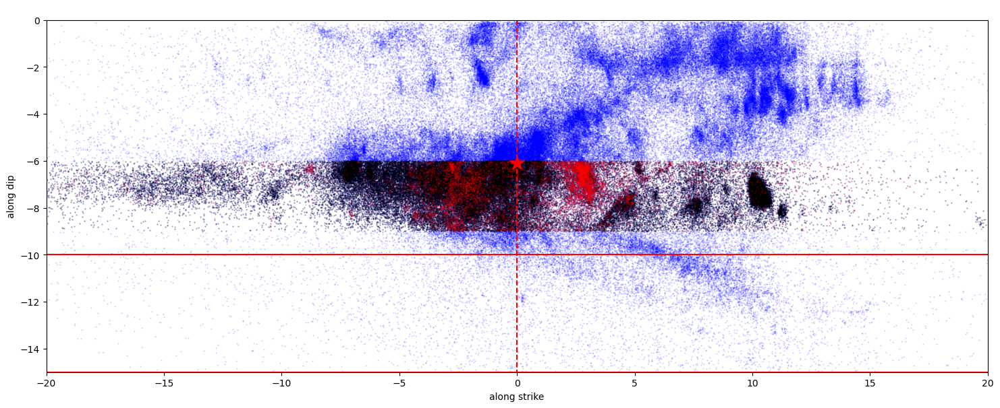

In [130]:
%matplotlib inline

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(18, 10))

ax.scatter( X_onsection_catal,(-am['depth'].loc[result_catal])/np.sin(dip_angle*np.pi/180),c='b',s=1,marker='.',alpha=.2,label='x')
ax.scatter(X_onsection_POSTevad_sel,(-am_POSTevad_sel['depth'])/np.sin(dip_angle*np.pi/180),c='k',s=2,marker='.',alpha=.2,label='x')
ax.scatter(X_onsection_PREevad_sel,(-am_PREevad_sel['depth'])/np.sin(dip_angle*np.pi/180),c='r',s=2,marker='.',alpha=.2,label='x')

ax.scatter(fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180), marker='*', c='r',s=250, label='Mw 6.5')
ax.plot([-20,20],[-15.0, -15.0],'r')
#ax.plot([-20,20],[-9.5, -9.5],'r--')
#ax.plot([-20,20],[-12.5, -12.5],'r--')
ax.plot([-20,20],[-10., -10.],'r')
ax.plot([0,0],[0, -15],'r--')
#ax.plot([16,16],[0, -15],'r--')
ax.set_ylim(-15,0)
ax.set_xlim(-20,20)
ax.set_aspect('equal', adjustable='box')
ax.set_ylabel('along dip')
ax.set_xlabel('along strike')
ax.set_title(' ')

In [131]:
# DISTANCE ORTHOGONAL TO STRIKE

Xmin=3.5
#Xmax=+15
Xmax=+12

where_PREevad_sel = ((X_onsection_PREevad_sel<Xmax) &(X_onsection_PREevad_sel>Xmin))
where_POSTevad_sel = ((X_onsection_POSTevad_sel<Xmax) &(X_onsection_POSTevad_sel>Xmin))

In [132]:

am_POSTevad_sel_box=am_POSTevad_sel.loc[where_POSTevad_sel]
am_POSTevad_sel_box= am_POSTevad_sel_box.reset_index(drop=True)
print(len(am_POSTevad_sel_box))
#am_POST_sel=am_POST.copy() #am_poM1.copy()
am_PREevad_sel_box=am_PREevad_sel.loc[where_PREevad_sel]
am_PREevad_sel_box= am_PREevad_sel_box.reset_index(drop=True)
print(len(am_PREevad_sel_box))

20299
2034


In [133]:

utmx_PREevad_sel_box,utmy_PREevad_sel_box=utm33(np.array(am_PREevad_sel_box['lon']),np.array(am_PREevad_sel_box['lat']))   # 1 day pre M 6.5
utmx_POSTevad_sel_box,utmy_POSTevad_sel_box=utm33(np.array(am_POSTevad_sel_box['lon']),np.array(am_POSTevad_sel_box['lat']))   # 1 day pre M 6.5
print(len(utmx_POSTevad_sel_box))


20299


In [134]:
X_on_PREevad_sel_box=+(utmy_PREevad_sel_box/1000-mainev_ref[1])*normal_ref[0]-(utmx_PREevad_sel_box/1000-mainev_ref[0])*normal_ref[1]
X_on_POSTevad_sel_box=+(utmy_POSTevad_sel_box/1000-mainev_ref[1])*normal_ref[0]-(utmx_POSTevad_sel_box/1000-mainev_ref[0])*normal_ref[1]


Text(0.5, 1.0, ' ')

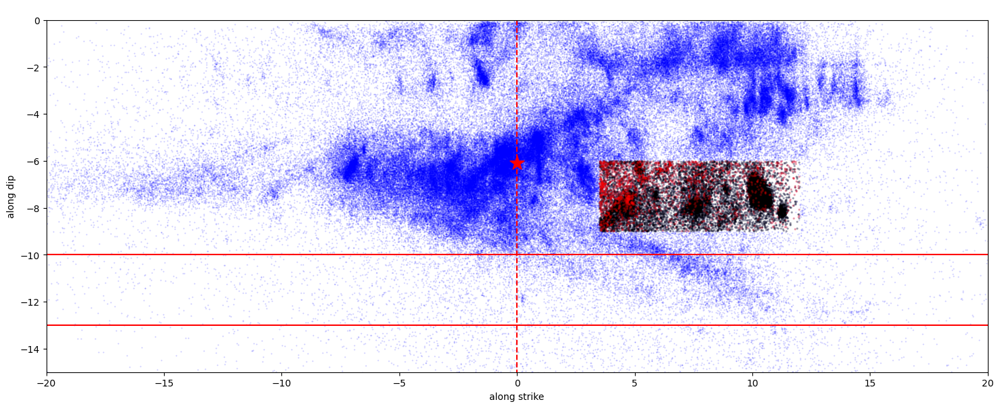

In [135]:
%matplotlib inline

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(18, 10))

ax.scatter( X_onsection_catal,(-am['depth'].loc[result_catal])/np.sin(dip_angle*np.pi/180),c='b',s=1,marker='.',alpha=.2,label='x')
ax.scatter(X_on_POSTevad_sel_box,(-am_POSTevad_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='k',s=10,marker='.',alpha=.2,label='x')
ax.scatter(X_on_PREevad_sel_box,(-am_PREevad_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='r',s=10,marker='.',alpha=.2,label='x')

ax.scatter(fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180), marker='*', c='r',s=250, label='Mw 6.5')
ax.plot([-20,20],[-13.0, -13.0],'r')
ax.plot([-20,20],[-10., -10.],'r')
ax.plot([0,0],[0, -15],'r--')
ax.set_ylim(-15,0)
ax.set_xlim(-20,20)
ax.set_aspect('equal', adjustable='box')
ax.set_ylabel('along dip')
ax.set_xlabel('along strike')
ax.set_title(' ')


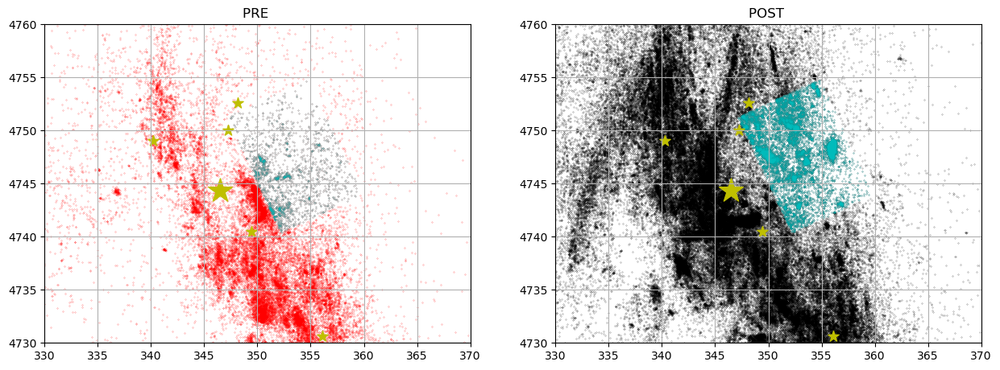

In [136]:
#%matplotlib qt
whegrandi=np.where(am['Mw'] >= 5)
%matplotlib inline

fig, axs = plt.subplots(1, 2, figsize=(15,15))

axs[0].scatter(utmx_PREevad/1000, utmy_PREevad/1000,s=0.1,marker='.', c='r', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTevad/1000, utmy_POSTevad/1000,s=0.1,marker='.', c='k', label='Tan et al., 2021')


axs[0].scatter(utmx_PREevad_sel_box/1000, utmy_PREevad_sel_box/1000,s=0.1,marker='.', c='c', label='Tan et al., 2021')
axs[1].scatter(utmx_POSTevad_sel_box/1000, utmy_POSTevad_sel_box/1000,s=0.1,marker='.', c='c', label='Tan et al., 2021')


axs[1].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[1].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')

axs[0].scatter(utmx_am[whegrandi]/1000, utmy_am[whegrandi]/1000, s=100,marker='*', c='y')
axs[0].scatter(mainev_ref[0], mainev_ref[1], s=500, c='y',marker='*', label='Norcia Mainshock')


axs[0].set_xlim(330,370)
axs[0].set_ylim(4730,4760)
axs[0].set_title('PRE ')
axs[1].set_title('POST ')
axs[1].set_xlim(330,370)
axs[1].set_ylim(4730,4760)



##plt.legend(fontsize=11, markerscale=2)
#axs[0]=plt.gca()
axs[0].set_aspect('equal')
axs[0].grid()

##plt.legend(fontsize=11, markerscale=2)
#axs[1]=plt.gca()
axs[1].set_aspect('equal')
axs[1].grid()

In [137]:
frames = [am_PREevad_sel_box, am_POSTevad_sel_box]
deepeva = pd.concat(frames)
deepeva=deepeva.reset_index(drop=True)
print(len(deepeva))

22333


100%|█████████████████████████████████████████████| 383/383 [00:13<00:00, 27.73it/s]
n_compl 4527
Mc-Lilliefors: 1.21
   --> number of events ≥ Mc-Lilliefors: 4527
1.21 3.94 -0.31 3.94

    b-value: 1.68232
    95% conf int: [1.73331, 1.63309]
3.6426623314420357 3.6426623314420357
eli_b_value_mle= 1.6823195207961468


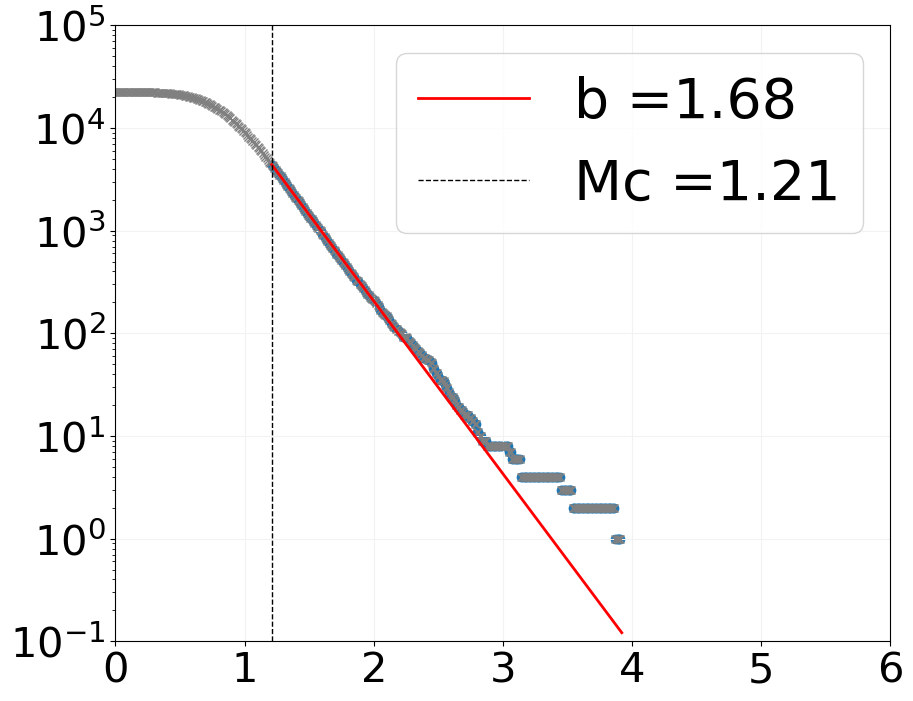

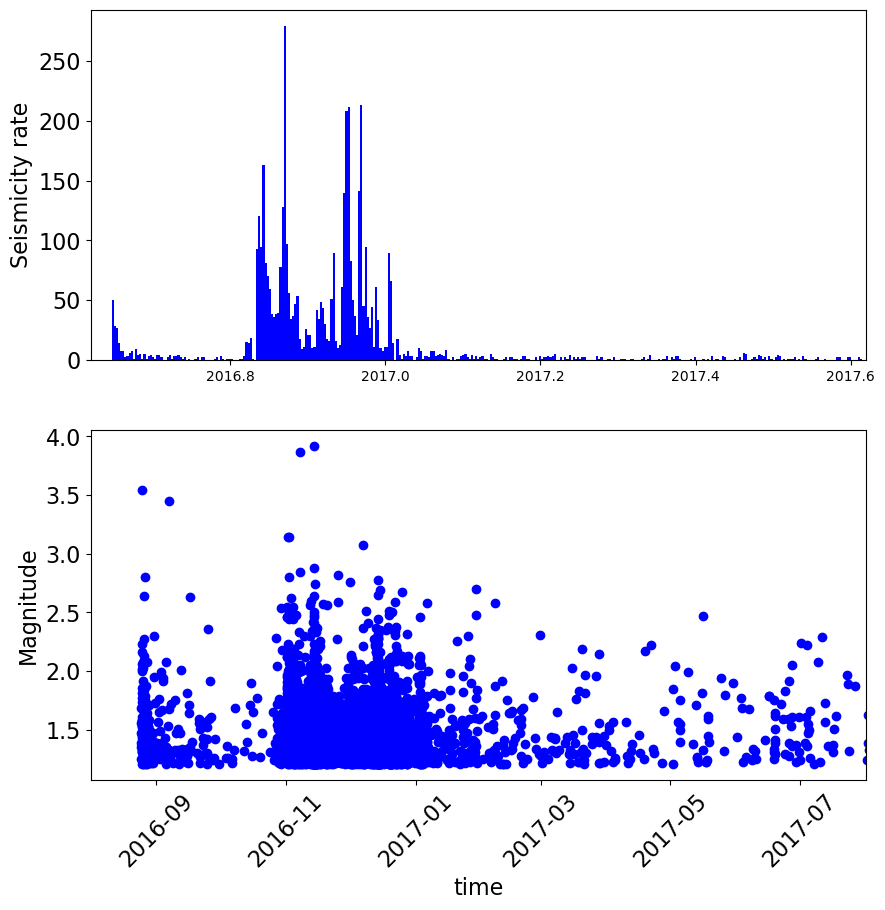

In [138]:
outputEVAD=compute_b_value(deepeva,interval)

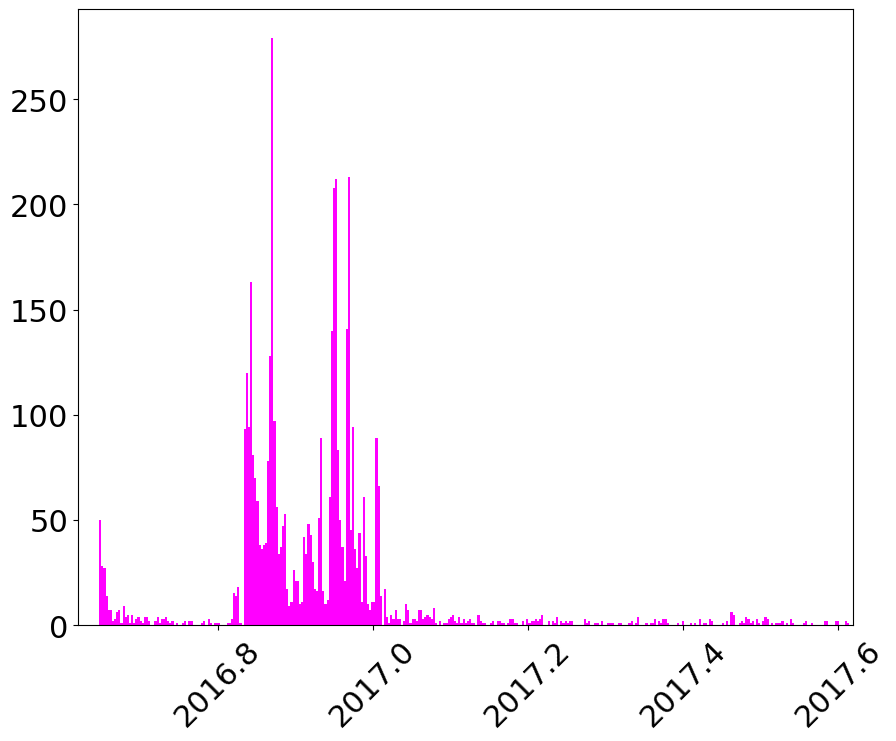

In [139]:
Mmin=outputEVAD[1]
colore='magenta'
plot_histo_selection(deepeva, Mmin, colore)

In [140]:
!mv b_value_plot.pdf b_deepeva_Tan_Mw.pdf
!mv seismicity_rate_subset.pdf seismicity_rate_subset_b_deepeva_Tan_Mw.pdf

In [141]:
B_value5[3]=outputEVAD[0]

In [142]:
Bpositive_5Mw[3],STD_positive[3]=estimate_b_positive(deepeva['Mw'],interval,dmc=dmc_value,return_std=True)

print(Bpositive_5Mw[3],STD_positive[3])


1.5391622805647132 0.013542305712569884


In [145]:
B_value5

array([1.34721167, 1.58167057, 1.43362865, 1.68231952, 1.47873061])

Tan_mw_min (1.2987352191951695, 1.518289000040156, 1.3694929858024993, 1.6330884688353589, 1.4363713497084183)
Tan_mw_max (1.398426850138195, 1.6486968786683787, 1.5024985201938366, 1.7333108104965769, 1.5228093658689867)


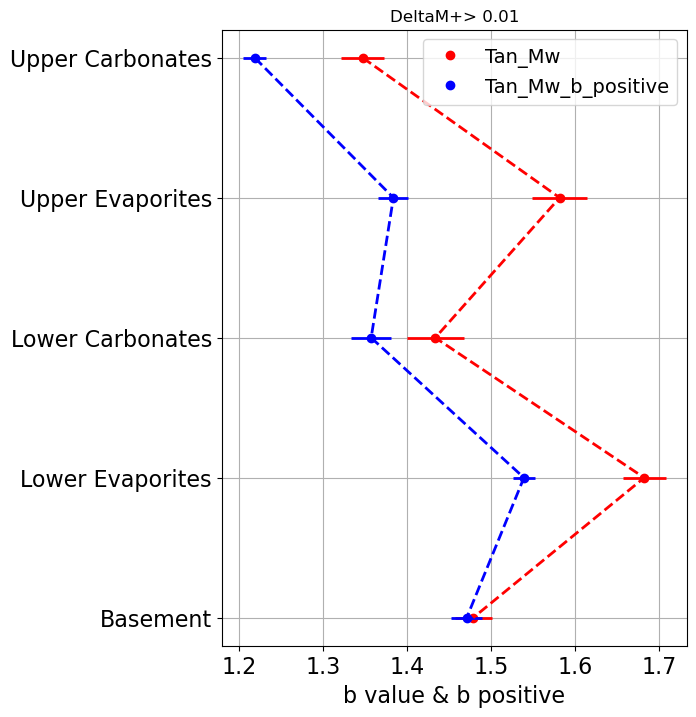

In [146]:
Litho = ['Upper Carbonates','Upper Evaporites','Lower Carbonates','Lower Evaporites','Basement']   # Categories
ls = '--'

Tan_mw=B_value5

ii=4
Tan_mw_min = (outputSHACA[ii],outputEVAS[ii],outputDEEPCA[ii],outputEVAD[ii],outputBASE[ii])
ii=3
Tan_mw_max = (outputSHACA[ii],outputEVAS[ii],outputDEEPCA[ii],outputEVAD[ii],outputBASE[ii])

print('Tan_mw_min',Tan_mw_min)
print('Tan_mw_max',Tan_mw_max)

Tan_on_mw=np.array([1.33])

fig, ax = plt.subplots(figsize=(6,8))
color=['red','blue','green']
#xerr_Tan_mw = [np.subtract(Tan_mw, Tan_mw_min), np.subtract(Tan_mw_max, Tan_mw)]
#ax.errorbar( Tan_mw, Litho, xerr=xerr_Tan_mw, c=color[0],linestyle=ls,linewidth=2)
ii=5
xerr_Tan_mw=(outputSHACA[ii],outputEVAS[ii],outputDEEPCA[ii],outputEVAD[ii],outputBASE[ii])
ax.errorbar( Tan_mw, Litho, xerr=xerr_Tan_mw, c=color[0],linestyle=ls,linewidth=2)
ax.plot(Tan_mw, Litho,'o',c=color[0],label='Tan_Mw')
#ax.plot(Bpositive_5Mw, Litho,'o',c=color[1],label='Tan_Mw_b_more_positive')
ax.plot(Bpositive_5Mw, Litho,'o',c=color[1],label='Tan_Mw_b_positive')

ax.errorbar( Bpositive_5Mw, Litho, xerr=STD_positive, c=color[1],linestyle=ls,linewidth=2)

ax.tick_params(axis='both', which='major', labelsize=16)
ax.invert_yaxis()
ax.set_xlabel('b value & b positive', fontsize=16)
plt.grid(True)
ax.legend(loc="upper right", fontsize=14)
ax.set_title(f"DeltaM+> {dmc_value}")
plt.savefig('b_positive_Litho_revised'+str(dmc_value)+'_dmc_value'+'.pdf', format="pdf", bbox_inches="tight")

#fig.savefig("b_positive_Litho_revised.pdf", bbox_inches='tight')

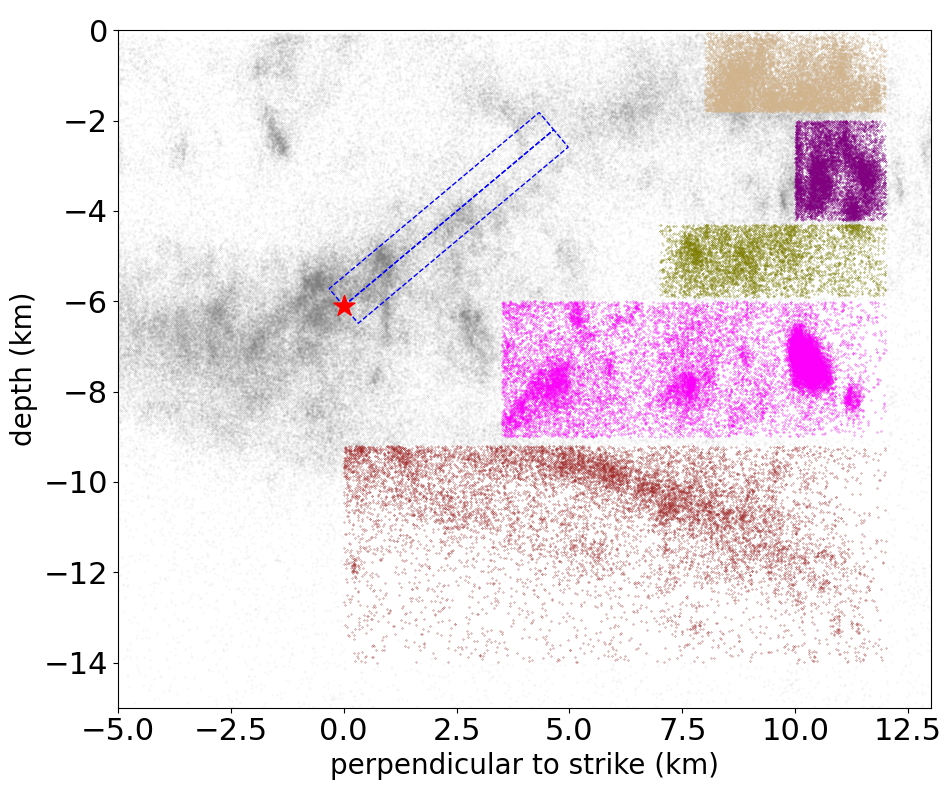

In [147]:
%matplotlib inline

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 8))

ax.scatter( X_onsection_catal,(-am['depth'].loc[result_catal])/np.sin(dip_angle*np.pi/180),c='gray',s=0.2,marker='.',alpha=.2)
ax.scatter(X_on_POSTevad_sel_box,(-am_POSTevad_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='magenta',s=0.2,marker='.')
ax.scatter(X_on_PREevad_sel_box,(-am_PREevad_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='magenta',s=0.2,marker='.')

ax.scatter(X_on_POSTevaS_sel_box,(-am_POSTevaS_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='purple',s=0.2,marker='.')
ax.scatter(X_on_PREevaS_sel_box,(-am_PREevaS_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='purple',s=0.2,marker='.')


ax.scatter(X_on_POSTcarbS_sel_box,(-am_POSTcarbS_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='tan',s=0.2,marker='.')
ax.scatter(X_on_PREcarbS_sel_box,(-am_PREcarbS_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='tan',s=0.2,marker='.')


ax.scatter(X_on_POSTcarb_sel_box,(-am_POSTcarb_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='olive',s=0.2,marker='.')
ax.scatter(X_on_PREcarb_sel_box,(-am_PREcarb_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='olive',s=0.2,marker='.')


ax.scatter(X_on_POSTs_sel_box,(-am_POSTs_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='brown',s=0.2,marker='.')
ax.scatter(X_on_PREs_sel_box,(-am_PREs_sel_box['depth'])/np.sin(dip_angle*np.pi/180),c='brown',s=0.2,marker='.')

rect1 = patches.Rectangle((fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180)), 6.07, 0.5, angle=40,linewidth=1, linestyle='--',edgecolor='b', facecolor='none')
ax.add_patch(rect1)
rect1 = patches.Rectangle((fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180)), 6.07, -0.5, angle=40,linewidth=1, linestyle='--', edgecolor='b', facecolor='none')
ax.add_patch(rect1)


ax.scatter(fm_onsection_ref, -depth_ref/np.sin(dip_angle*np.pi/180), marker='*', c='r',s=250, label='Mw 6.5')
#ax.plot([-20,20],[-13.0, -13.0],'r')
#ax.plot([0,0],[0, -15],'r--')
#ax.plot([16,16],[0, -15],'r--')
ax.set_ylim(-15,0)
ax.set_xlim(-5,13)
ax.set_aspect('equal', adjustable='box')

ax.tick_params(axis='both', which='major', labelsize=22)
ax.set_ylabel('depth (km)', fontsize=20)
ax.set_xlabel('perpendicular to strike (km)', fontsize=20)
ax.set_title(' ')
plt.tight_layout()
ax.set_aspect('equal', adjustable='box')
fig.savefig("Selected_seismicity_Tan.pdf", bbox_inches='tight',dpi=100)